In [ ]:
#Importing libraries
import cv2
import matplotlib.pyplot as plt
import numpy as np
#Mounting google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# a) Take a night time photo with your phone camera (if your phone camera is already very good, then borrowsomeone else’s phone) and try to enhance it by manipulating its histogram and reducing noise. It should stilllook natural and like a night time photo, but more details should be apparent than before

Original image

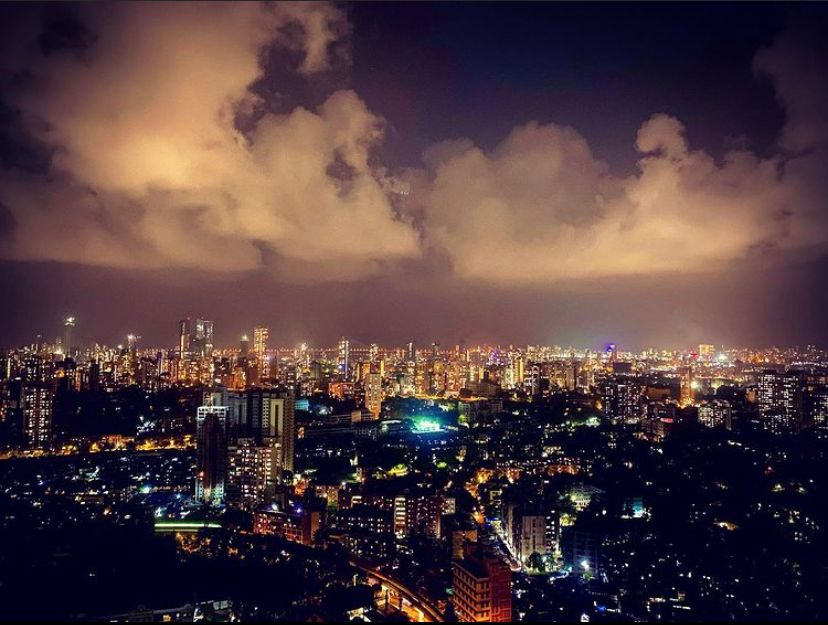

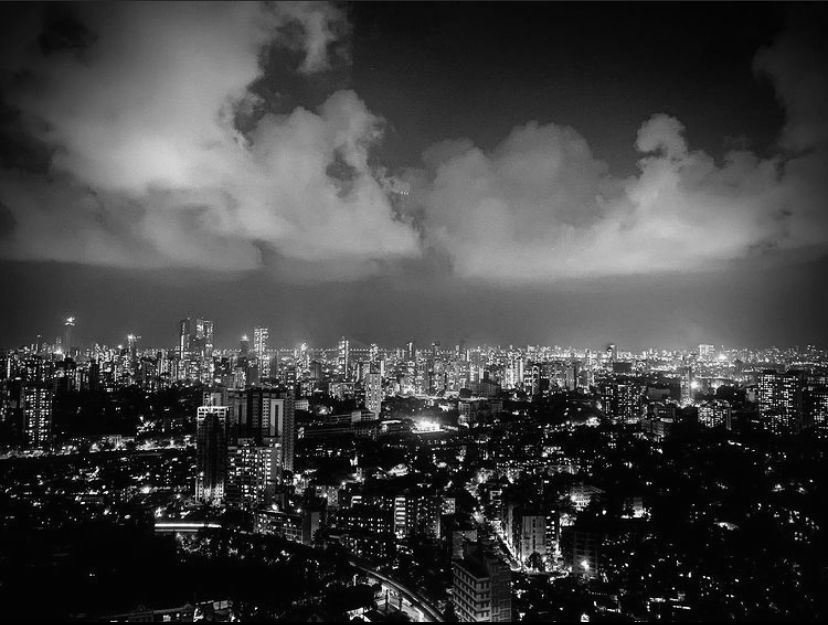

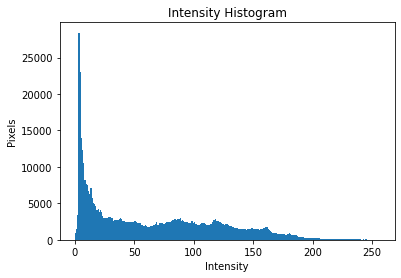

In [ ]:
#Reading the color image in jpg format
image1=cv2.imread('/content/drive/MyDrive/ee610_ass1/Nightshot2.jpg')
from google.colab.patches import cv2_imshow
#Displaying the color image
cv2_imshow(image1)
#making copies of the image for using further
image1a=image1.copy()
image1b=image1.copy()
image1c=image1.copy()
image1d=image1.copy()
#converting the image to grayscale and displaying it
gray = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)
#Displaying the histogram of the grayscale image
plt.hist(gray.ravel(),256,[0,256])
plt.xlabel('Intensity')
plt.ylabel('Pixels')
plt.title('Intensity Histogram')
plt.show()

After Noise removal

For noise removal, I noted that using a gaussian filter for smoothening also blurs the edges of the image. However, a bilateral filter keeps the edges sharp while removing noise from the image.

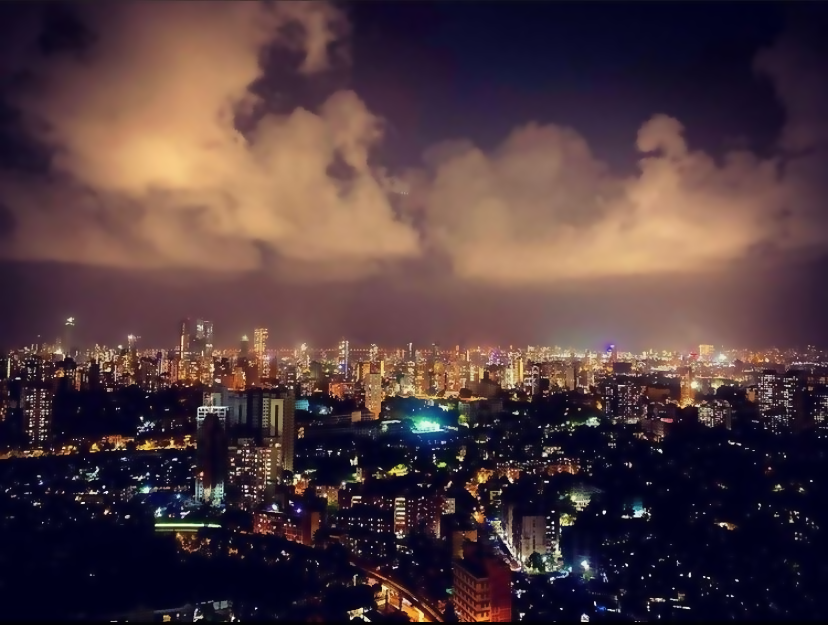

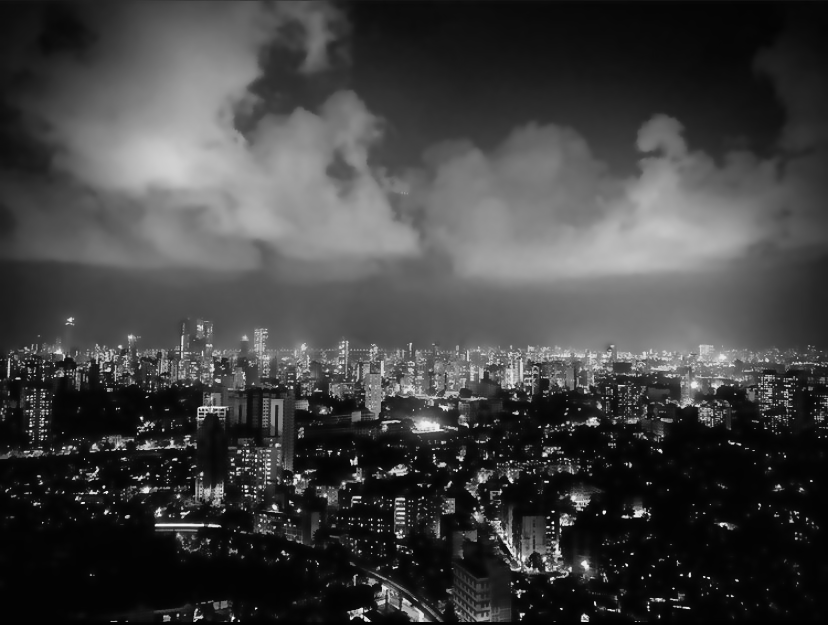

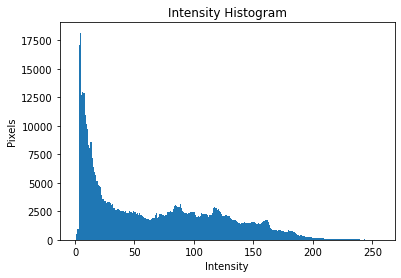

In [ ]:
#Using a bilateral filter to remove noise
blur = cv2.bilateralFilter(image1a,9,75,75)
#Tking grayscale of the image
blurg = cv2.cvtColor(blur, cv2.COLOR_BGR2GRAY)
cv2_imshow(blur)
cv2_imshow(blurg)
#displaying the histogram of the grayscale image
plt.hist(blurg.ravel(),256,[0,256])
plt.xlabel('Intensity')
plt.ylabel('Pixels')
plt.title('Intensity Histogram')
plt.show()

Ideal image for histogram matching

I tried different gamma transforms and gamma=2 looked the most appealing. I will use it for histogram specification.

gamma=2


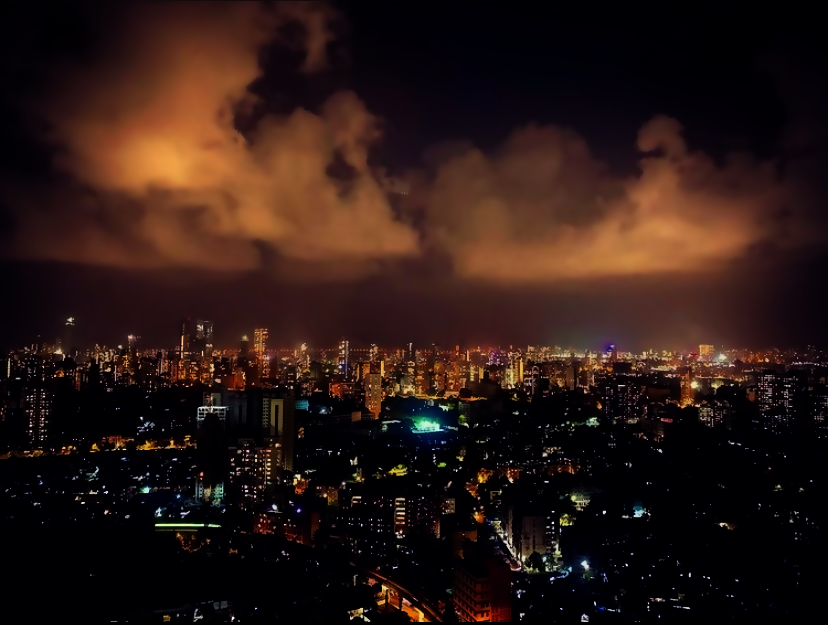

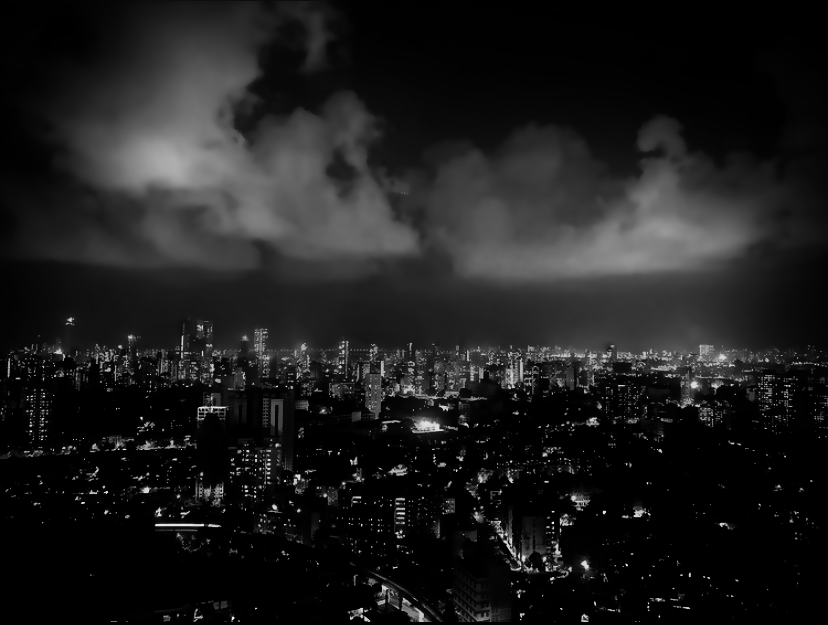

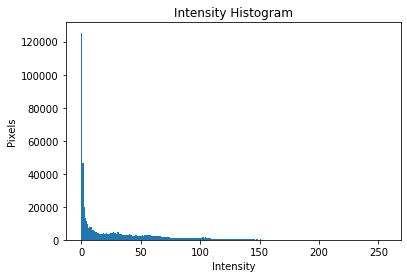

In [ ]:
#Gamma transform, gamma=2
print ('gamma=2')
for i in range(625):
  for j in range(828):
    for k in range(3):
      image1b[i,j,k]=(blur[i,j,k]**2)*0.00392156
cv2_imshow(image1b)
#Displaying the histogram of the grayscale image
gammag = cv2.cvtColor(image1b, cv2.COLOR_BGR2GRAY)
plt.hist(gammag.ravel(),256,[0,256])
cv2_imshow(gammag)
plt.xlabel('Intensity')
plt.ylabel('Pixels')
plt.title('Intensity Histogram')
plt.show()


Histogram matching 

Using the exact same method as was used in assignment1 q5

I have used the same code as my assignment 1 q5 here because the method is the same(for histogram matching)

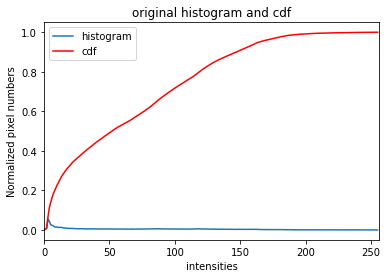

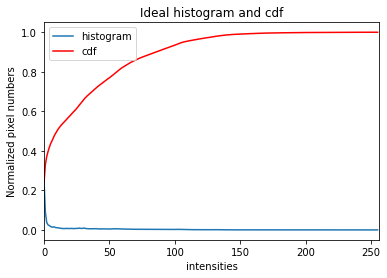

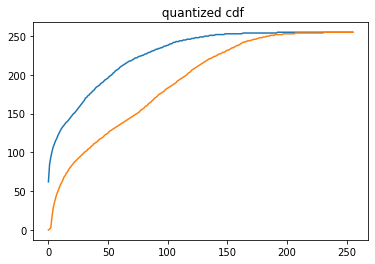

In [ ]:
#original gray image
image1e=gray.copy()
#Creating a histogram
hist,bins = np.histogram(image1e.flatten(),256,[0,256])
#Normalizing the histogram by dividing by no of pixels
hist=hist/517500
#Plotting the histogram and CDF for the original image
plt.plot(hist)
cdf = hist.cumsum()
plt.plot(cdf, color = 'r')
plt.xlim([0,256])
plt.title('original histogram and cdf')
plt.xlabel('intensities')
plt.ylabel('Normalized pixel numbers')
plt.legend(('histogram','cdf'), loc = 'upper left')
plt.show()
#converting ideal image to grayscale
idealgray= gammag.copy()
#creating a histogram
hist2,bins = np.histogram(idealgray.flatten(),256,[0,256])
#Normalizing the histogram by dividing by no of pixels
hist2=hist2/517500
#Plotting the histogram and CDF
plt.plot(hist2)
cdf2 = hist2.cumsum()
plt.plot(cdf2, color = 'r')
plt.title('Ideal histogram and cdf')
plt.xlabel('intensities')
plt.ylabel('Normalized pixel numbers')
plt.xlim([0,256])
plt.legend(('histogram','cdf'), loc = 'upper left')
plt.show()
#Rounding off the ideal cdf to nearest integers after multiplying with L-1 to get 255 discrete levels
cdfround=np.rint(cdf2*255)
plt.title('ideal quantized cdf')
plt.plot(cdfround)
#Rounding off the original cdf to nearest integers after multiplying with L-1 to get 255 discrete levels
cdfroundori=np.rint(cdf*255)
plt.title(' quantized cdf')
plt.plot(cdfroundori)
#The two quantised CDFs were plotted in the same graph
#Changing the datatype of the two arrays to int
cdfround = cdfround.astype('int')
cdfroundori = cdfroundori.astype('int')
#t1 will be our transform array which we apply after histogram equalization to get the new histogram
#It is basically the inverse of the ideal quantized CDF that we had obtained
#i.e. given the y values of the ideal cdf plot, the x values will be returned
t1=np.zeros(256)
for i in range(1,256):
  #For all values between two particular levels of the cdf, we assign the index of the cdf array 
  #for eg, for 76 to 92 elements of t1, we assign intensity value 0,which is the index of 76, for 93 to 99, we assign 1,which is the index of 93, and so on.
  #As the values correspong to the y coordinate and index to x
  for j in range(cdfround[i-1],cdfround[i]):
    t1[j]=i
#Finally give 255 value to the last element (CDF property)
t1[255]=255

Final Image

We can see that the noise has been significantly reduced but the final image is detailed and vibrant.

Final Image:


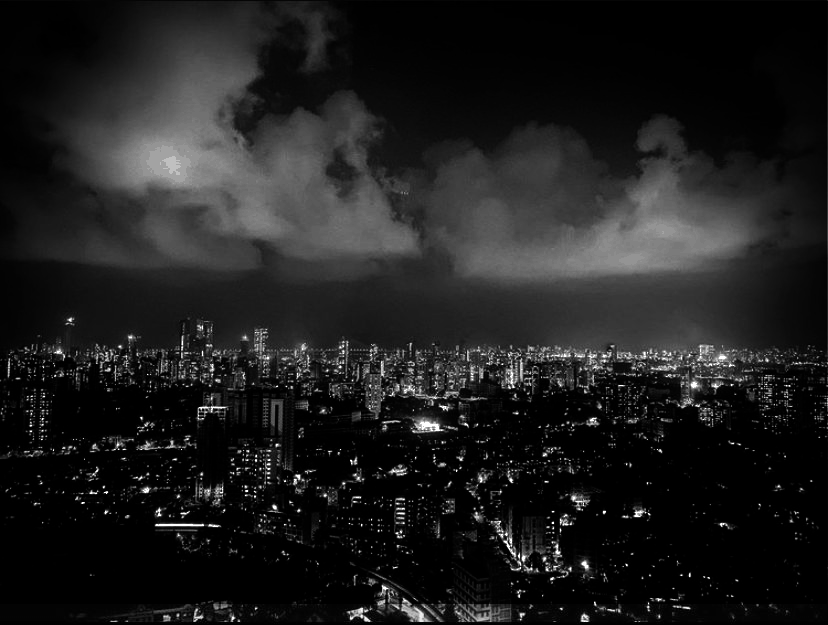

Original Image:


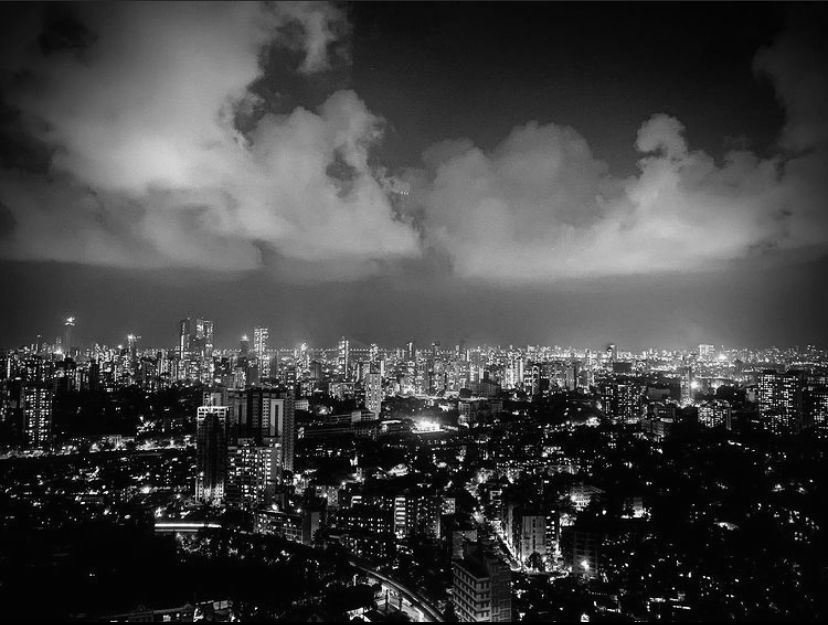

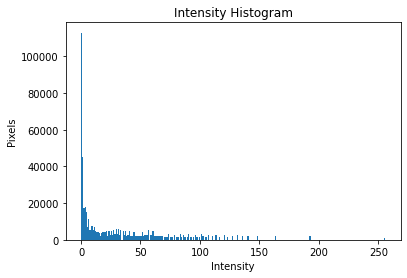

In [ ]:
#Step 1: Histogram equalization by applying the original CDF.
middle=image1e.copy()
for i in range(604):
  for j in range(827):
    middle[i,j]=(cdfroundori[image1e[i,j]])
#Step 2: Applying the t1 transform on the equalized image (Inverse of ideal CDF)
final=image1e.copy()
for i in range(604):
  for j in range(827):
    final[i,j]=(t1[middle[i,j]])
#Displaying the final result and the original image
print("Final Image:")
cv2_imshow(final)
print("Original Image:")
cv2_imshow(gray)
plt.hist(final.ravel(),256,[0,256])
plt.xlabel('Intensity')
plt.ylabel('Pixels')
plt.title('Intensity Histogram')
plt.show()

# b) Remove the newspaper-ink-dot effect and try to make the image at https://momofilmfest.com/wpcontent/uploads/2020/01/newspaper-dots.jpg more natural-looking

Original image

In [ ]:
#importing important libraries
import numpy as np
import matplotlib.pyplot as plt


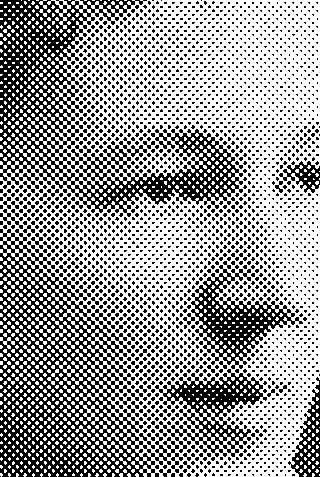

In [ ]:
#Reading the image in jpg format
image2=cv2.imread('/content/drive/MyDrive/ee610_ass1/newspaper-dots.jpg')
from google.colab.patches import cv2_imshow
#Displaying the  image
cv2_imshow(image2)
#making copies of the image for using further
image2a=image2.copy()
image2b=image2.copy()
image2c=image2.copy()
image2d=image2.copy()
#Flattening the image to one channel as even if it is in grayscale the shape of the image doesnt match
gray2 = cv2.cvtColor(image2a, cv2.COLOR_BGR2GRAY)


Fourier Transform

As we can see, the dots are represented by these periodic spots in the fourier transform and they will need to be removed

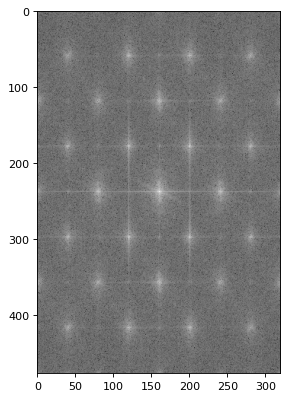

In [ ]:
#Taking fourier transform of the image and plotting it on a log scale for better visibility
dark_image_grey_fourier = np.fft.fftshift(np.fft.fft2(gray2))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(dark_image_grey_fourier)), cmap='gray');

(477, 320)


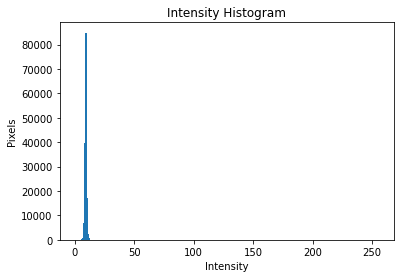

/usr/local/lib/python3.7/dist-packages/numpy/lib/histograms.py:852: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/usr/local/lib/python3.7/dist-packages/matplotlib/transforms.py:789: ComplexWarning: Casting complex values to real discards the imaginary part
  points = np.array(args, dtype=float).reshape(2, 2)
/usr/local/lib/python3.7/dist-packages/matplotlib/transforms.py:1969: ComplexWarning: Casting complex values to real discards the imaginary part
  x, y = float(x), float(y)


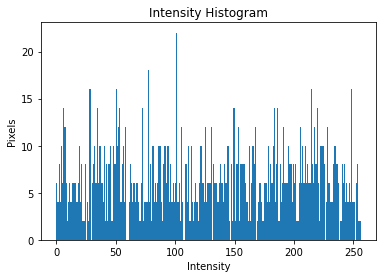

In [ ]:
#Converying the fourier transform to a numpy array and checking its shape, which should match image shape
arr= np.asarray( dark_image_grey_fourier ) 
print(arr.shape)
#Plotting histogram of fourier transform to see its intensity distribution, first on logarithmic scale, then on normal scale
plt.hist(np.log(abs(arr)).ravel(),256,[0,256])
plt.xlabel('Intensity')
plt.ylabel('Pixels')
plt.title('Intensity Histogram')
plt.show()
plt.hist(arr.ravel(),256,[0,256])
plt.xlabel('Intensity')
plt.ylabel('Pixels')
plt.title('Intensity Histogram')
plt.show()

Low pass filter mask

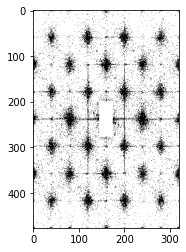

In [ ]:
#Creating a low pass filter mask, which will be multiplied with the image fourier transform
#This mask will set all pixels above a certain brightness to zero and keep the others as they are
mask=arr.copy()
#Using log scale as it is better to visualise as we printed it and saw the transform
#Setting value to 0.01 and not zero as log of zero not defined so we wont be able to display it if it was zero
#But then it is later rounded off and taken care of
logarr= np.log(abs(dark_image_grey_fourier))
final=arr.copy()
#We define a region around the central region where we will apply the filter as the central region has important image information
for i in range(0,200):
  for j in range(320):
    if logarr[i,j]>10:
      mask[i,j]=0.001
    else:
      mask[i,j]=1
for i in range(277,477):
  for j in range(320):
    if logarr[i,j]>10:
      mask[i,j]=0.001
    else:
      mask[i,j]=1
for i in range(200,277):
  for j in range(145,175):
     mask[i,j]=1 
for i in range(200,277):
  for j in range(0,145):
    if logarr[i,j]>10:
      mask[i,j]=0.001
    else:
      mask[i,j]=1
for i in range(200,277):
  for j in range(175,320):
    if logarr[i,j]>10:
      mask[i,j]=0.001
    else:
      mask[i,j]=1
#Displaying the mask that we created
plt.imshow(np.log(abs(mask)), cmap='gray');

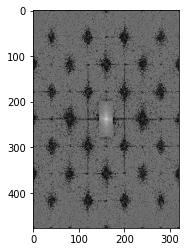

In [ ]:
#Multiplying the mask with the image fourier transform to get a new fourier transform
for i in range(477):
  for j in range(320):
    arr[i,j]=arr[i,j]*mask[i,j]
plt.imshow(np.log(abs(arr)), cmap='gray');

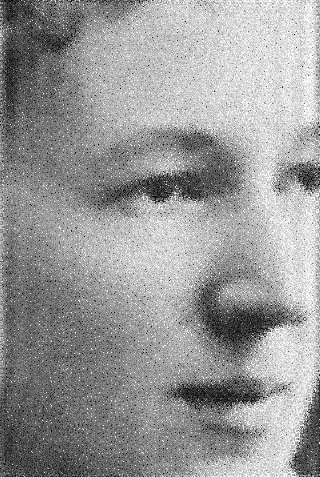

In [ ]:
#Taking inverse fourier transform of the masked fft
cv2_imshow(abs(np.fft.ifft2(arr)))

Final image edits after after inverse fourier transform

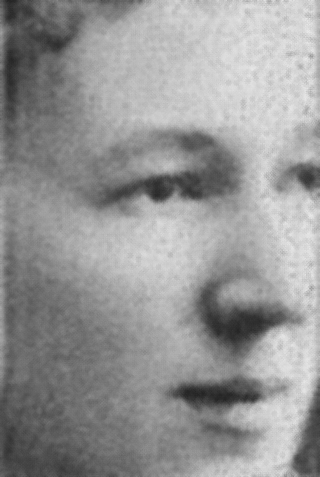

In [ ]:
#As we can see there are still small spots.
#We will remove these by smoothening the image(Bilateral filter
blur2 = cv2.bilateralFilter(np.uint8(abs(np.fft.ifft2(arr))),6,500,500)
cv2_imshow(blur2)

gamma=1.3


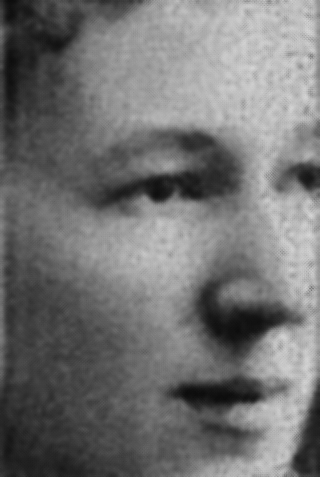

In [ ]:
#As we can see, the image is very light
#We can change this by using a gamma transform that will darken the darker regions and make the image more natural
print ('gamma=1.3')
for i in range(477):
  for j in range(320):
      image2c[i,j]=(blur2[i,j]**1.3)/5.272
cv2_imshow(image2c)

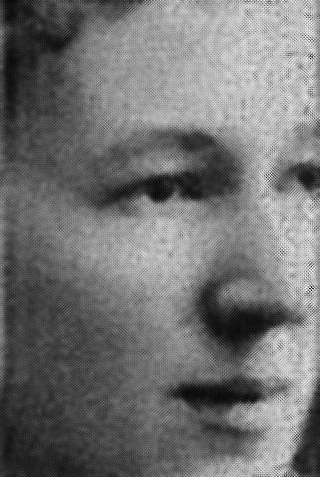

In [ ]:
#I also tried sharpening this image by using a sharpening kernel..
#However, More dots begin to appear on doing this and the image looks less natural
kernel = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
image2d = cv2.filter2D(image2c, -1, kernel)
cv2_imshow(image2d)

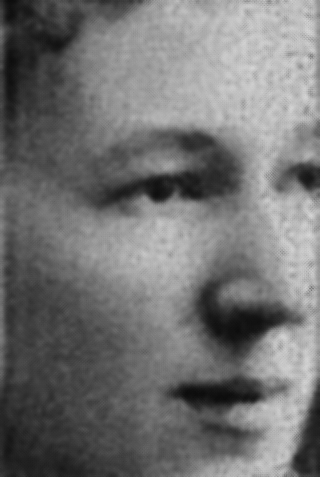

In [ ]:
#Thus I have chosen the second last image as the final image(After application of the gamma transform)
cv2_imshow(image2c)

This image is much more natural looking than it was at the beginning

Reference for taking fft and ifft: https://towardsdatascience.com/image-processing-with-python-application-of-fourier-transformation-5a8584dc175b

# c) Triton is the largest of Neptune’s satellites (moons), and is the most unusual in our solar system as it orbitsits planet in the opposite direction to the planet’s rotation. One of its images taken by Voyager 2 in 1989 ishosted at https://www.wired.com/images_blogs/thisdayintech/2009/08/triton_voyager2.jpg. This pictureseems to have some subtle horizontal (and possibly vertical) scan lines. Enhance this image by removing thescanning artifacts. Also try to reveal more details by manipulating the histogram. You can choose to work ona sub-image or a gray scale version, but for full marks maintain the color balance (ratio of R:G:B at each pixel)and work with all three channels and show the final result on the entire (or a large portion of the) image

For this question, originally, I tried taking each quadrant, and taking its fourir transform. On doing that, horizontal and verical lines were visible. I used a notch filter to mask those lines. Then I took inverse fourier transform and joined all quadrants together. However, on using this approach, more scan lines were visible in the image whereas almost none has been visible in the beginning. I even tried applying the notch filter on the fourier transform of the entire image after combining the quadrants but that degraded it further. The code for the above steps is at the end of this sub question(commented)

Second approach:

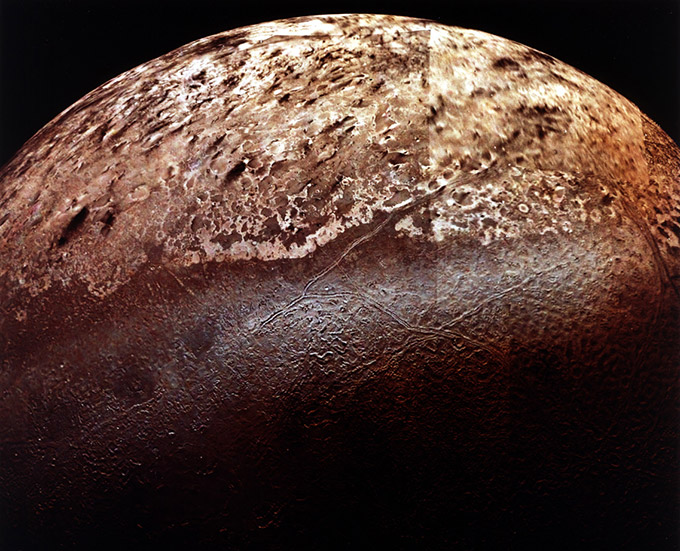

In [ ]:
#Reading the image from drive
image3=cv2.imread('/content/drive/MyDrive/ee610_ass1/triton_voyager2.jpg')
from google.colab.patches import cv2_imshow
#Displaying the waterfall color image
cv2_imshow(image3)
#making copies of the image for using further
image3a=image3.copy()
image3b=image3.copy()
image3c=image3.copy()
image3d=image3.copy()


In [ ]:
#Printing the image shape
print(image3.shape)

(551, 680, 3)


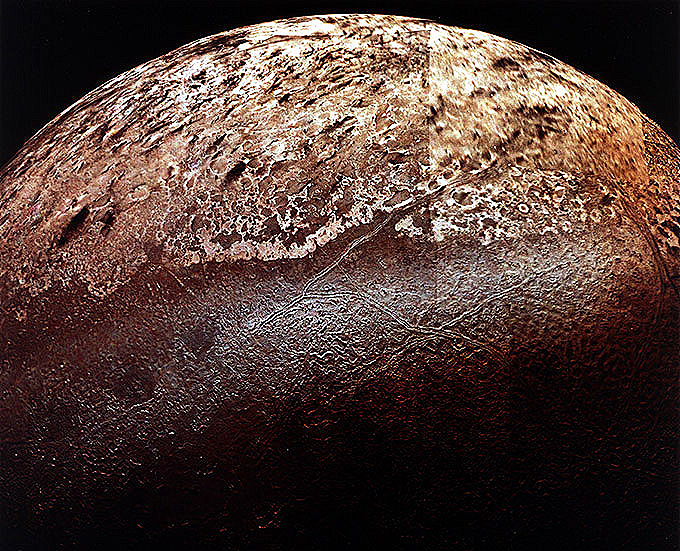

In [ ]:
#I tried using a sharpening kernel to sharpen the image to make any scan lines more prominebt so that they will be visible in the fourier domain
kernel = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
image3b = cv2.filter2D(image3a, -1, kernel)
cv2_imshow(image3b)


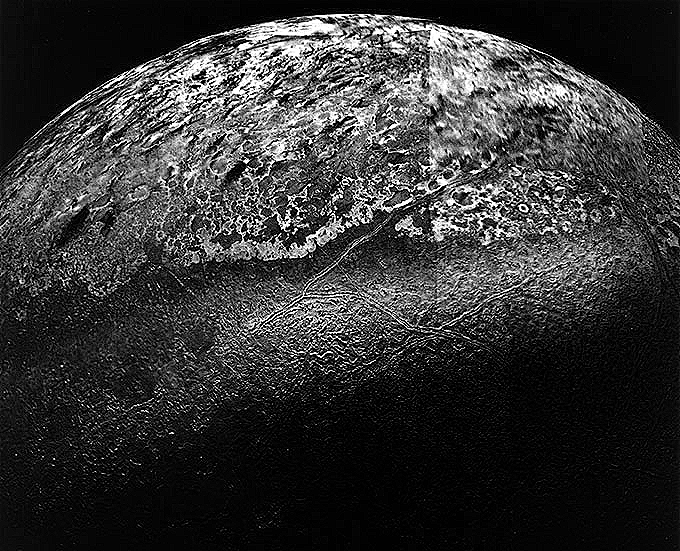

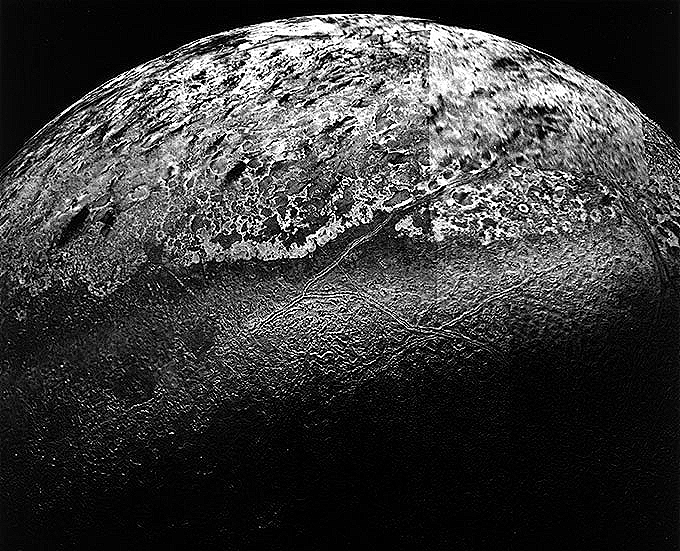

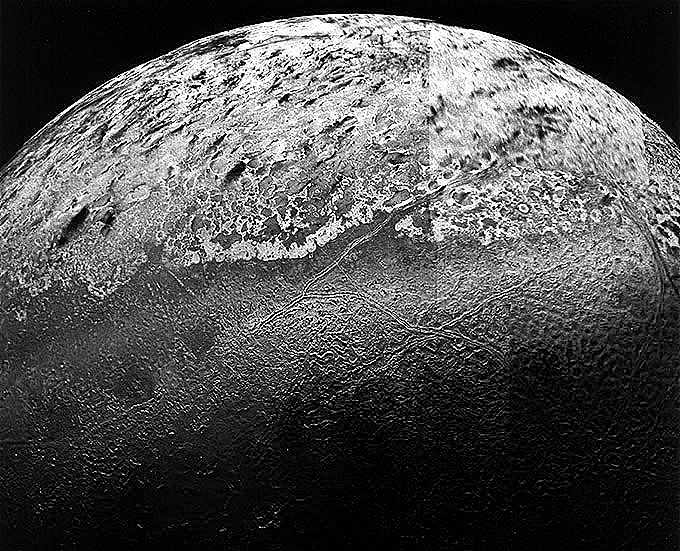

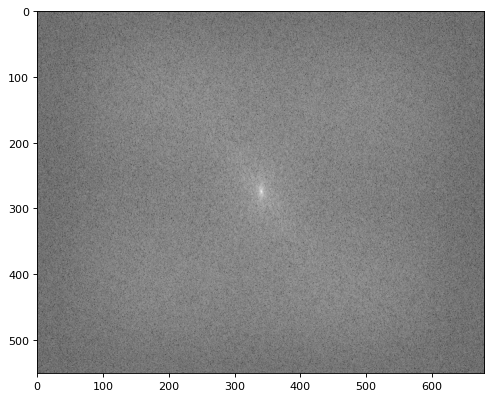

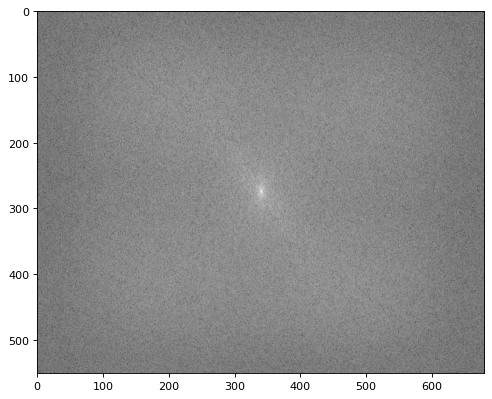

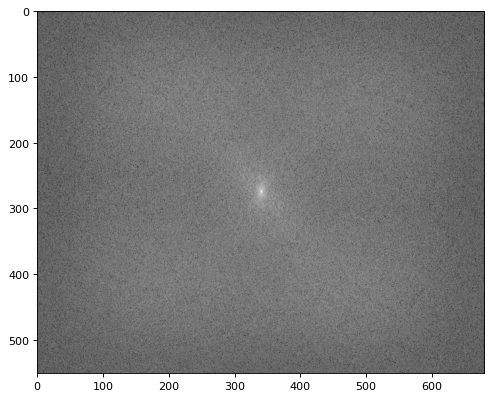

In [ ]:
#Making 3 arrays to store each channel of the image
image3bl=np.zeros((551,680), dtype=int)
image3gr=np.zeros((551,680), dtype=int)
image3re=np.zeros((551,680), dtype=int)

#Separating the blue green red image channels
for i in range(551):
  for j in range(680):
      image3bl[i,j]=image3b[i,j,0]
      image3gr[i,j]=image3b[i,j,1]
      image3re[i,j]=image3b[i,j,2]
cv2_imshow(image3bl)
cv2_imshow(image3gr)
cv2_imshow(image3re)

#Taking the fourier transform of each channel and displaying it using a logarithmic scale
bfourier = np.fft.fftshift(np.fft.fft2(image3bl))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(bfourier)), cmap='gray');
gfourier = np.fft.fftshift(np.fft.fft2(image3gr))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(gfourier)), cmap='gray');
rfourier = np.fft.fftshift(np.fft.fft2(image3re))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(rfourier)), cmap='gray');
#Storing the fourier transforms as numpy arrays
arrr= np.asarray(rfourier) 
arrb= np.asarray(bfourier) 
arrg= np.asarray(gfourier) 

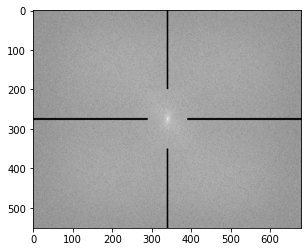

In [ ]:
#Using a notch filter on the fourier transform of each channel (setting the vertical and horizontal axes-except the centre as zero)
#As the central part has important information
#I adjusted the lengths and widths of the notch filter until the final image looked good and didnt have scan lines
arrrmasked=arrr.copy()
for i in range(273,278):
  for j in range(0,290):
      arrrmasked[i,j]=0.1
for i in range(273,278):
  for j in range(390,680):
      arrrmasked[i,j]=0.1
for i in range(0,200):
  for j in range(338,342):
      arrrmasked[i,j]=0.1
for i in range(350,551):
  for j in range(338,342):
      arrrmasked[i,j]=0.1
plt.imshow(np.log(abs(arrrmasked)), cmap='gray');

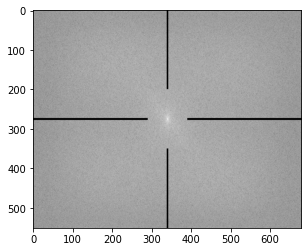

In [ ]:
#Using a notch filter on the fourier transform of each channel (setting the vertical and horizontal axes-except the centre as zero)
#As the central part has important information
#I adjusted the lengths and widths of the notch filter until the final image looked good and didnt have scan lines
arrgmasked=arrg.copy()
for i in range(273,278):
  for j in range(0,290):
      arrgmasked[i,j]=0.1
for i in range(273,278):
  for j in range(390,680):
      arrgmasked[i,j]=0.1
for i in range(0,200):
  for j in range(338,342):
      arrgmasked[i,j]=0.1
for i in range(350,551):
  for j in range(338,342):
      arrgmasked[i,j]=0.1
plt.imshow(np.log(abs(arrgmasked)), cmap='gray');


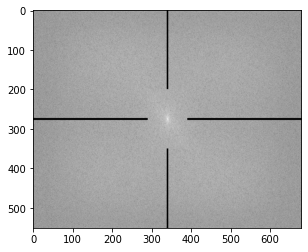

In [ ]:
#Using a notch filter on the fourier transform of each channel (setting the vertical and horizontal axes-except the centre as zero)
#As the central part has important information
#I adjusted the lengths and widths of the notch filter until the final image looked good and didnt have scan lines
arrbmasked=arrb.copy()
for i in range(273,278):
  for j in range(0,290):
      arrbmasked[i,j]=0.1
for i in range(273,278):
  for j in range(390,680):
      arrbmasked[i,j]=0.1
for i in range(0,200):
  for j in range(338,342):
      arrbmasked[i,j]=0.1
for i in range(350,551):
  for j in range(338,342):
      arrbmasked[i,j]=0.1
plt.imshow(np.log(abs(arrbmasked)), cmap='gray');

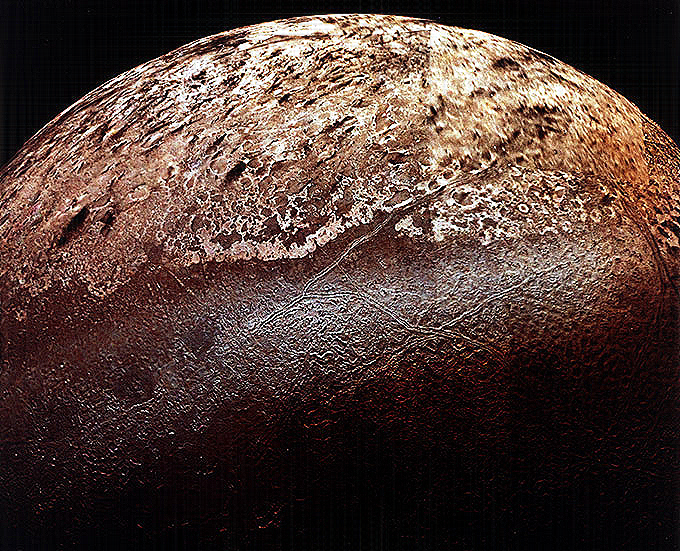

In [ ]:
#Taking inverse fourier transform of the filtered fourier transforms
invr=(abs(np.fft.ifft2(arrrmasked)))
invb=(abs(np.fft.ifft2(arrbmasked)))
invg=(abs(np.fft.ifft2(arrgmasked)))

#Merging the channels back and displaying the image
for i in range(551):
  for j in range(680):
      image3c[i,j,0]=np.clip(invb[i,j],0,255)
      image3c[i,j,1]=np.clip(invg[i,j],0,255)
      image3c[i,j,2]=np.clip(invr[i,j],0,255)
cv2_imshow(image3c)
#As we can see, scan lines are less prominent now, but still visible

gamma=1.5


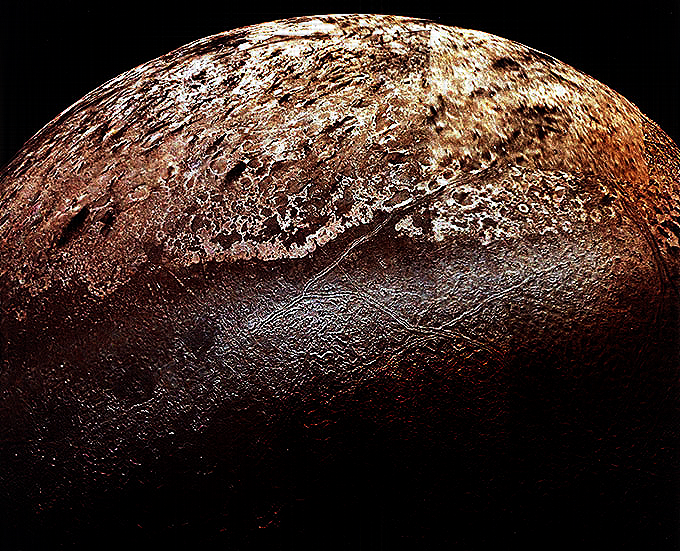

In [ ]:
#Taking a gamma transform to highlihght the details of the image and darken some scan lines in the black region
print ('gamma=1.5')
for i in range(551):
  for j in range(680):
    for k in range(3):
      image3d[i,j,k]=(image3c[i,j,k]**1.5)/16
cv2_imshow(image3d)

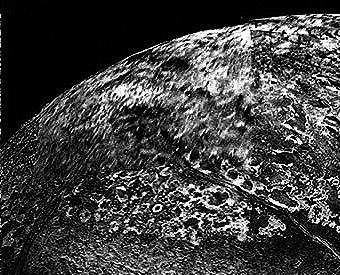

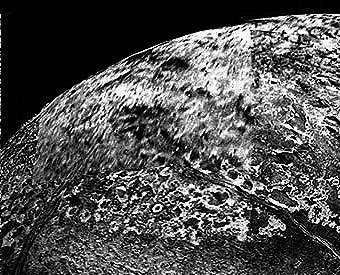

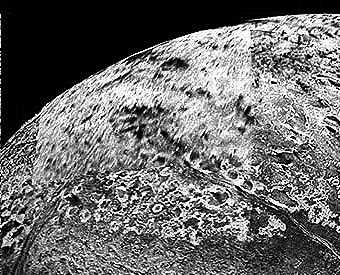

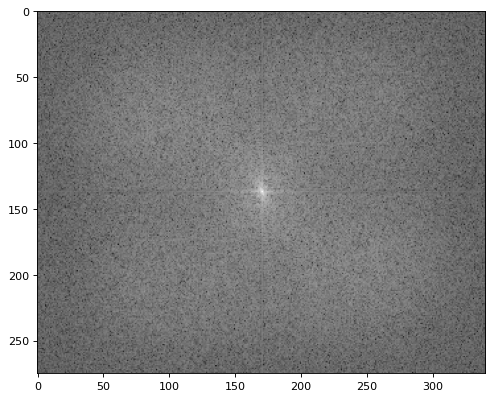

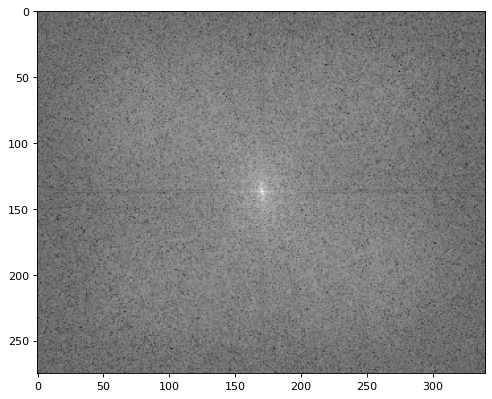

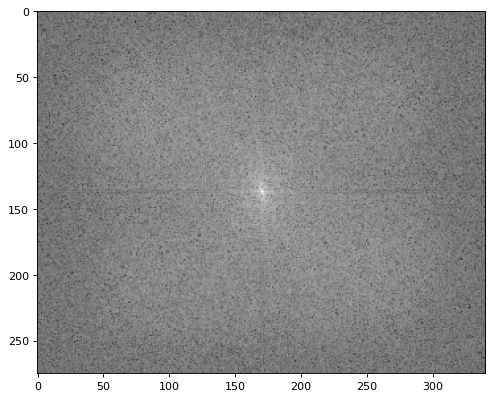

In [ ]:
#We can still see one very prominent scan line in one of the quadrants 
#So we will take that quadrant and apply the notch filter to it in the same way as above to try to blur the line

#Making 3 arrays to store each channel of the image
image3hb=np.zeros((275,340), dtype=int)
image3hg=np.zeros((275,340), dtype=int)
image3hr=np.zeros((275,340), dtype=int)

#Separating the blue green red image channels
for i in range(275):
  for j in range(340,680):
      image3hb[i,340-j]=image3d[i,j,0]
      image3hg[i,340-j]=image3d[i,j,1]
      image3hr[i,340-j]=image3d[i,j,2]
cv2_imshow(image3hb)
cv2_imshow(image3hg)
cv2_imshow(image3hr)

#Taking the fourier transform of each channel and displaying it using a logarithmic scale
quad4rfourier = np.fft.fftshift(np.fft.fft2(image3hr))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(quad4rfourier)), cmap='gray');
quad4bfourier = np.fft.fftshift(np.fft.fft2(image3hb))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(quad4bfourier)), cmap='gray');
quad4gfourier = np.fft.fftshift(np.fft.fft2(image3hg))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(quad4gfourier)), cmap='gray');
#Storing the fourier transforms as numpy arrays
arrq4r= np.asarray(quad4rfourier) 
arrq4b= np.asarray(quad4bfourier) 
arrq4g= np.asarray(quad4gfourier) 

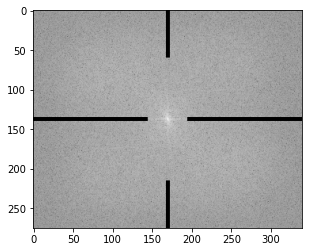

In [ ]:
#Using a notch filter on the fourier transform of each channel (setting the vertical and horizontal axes-except the centre as zero)
#As the central part has important information
#I adjusted the lengths and widths of the notch filter until the final image looked good and didnt have scan lines
arrq4rmasked=arrq4r.copy()
for i in range(135,140):
  for j in range(0,145):
      arrq4rmasked[i,j]=0.1
for i in range(135,140):
  for j in range(195,340):
      arrq4rmasked[i,j]=0.1
for i in range(0,60):
  for j in range(168,173):
      arrq4rmasked[i,j]=0.1
for i in range(215,275):
  for j in range(168,173):
      arrq4rmasked[i,j]=0.1
plt.imshow(np.log(abs(arrq4rmasked)), cmap='gray');


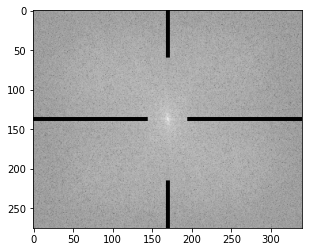

In [ ]:
#Using a notch filter on the fourier transform of each channel (setting the vertical and horizontal axes-except the centre as zero)
#As the central part has important information
#I adjusted the lengths and widths of the notch filter until the final image looked good and didnt have scan lines
arrq4bmasked=arrq4b.copy()
for i in range(135,140):
  for j in range(0,145):
      arrq4bmasked[i,j]=0.1
for i in range(135,140):
  for j in range(195,340):
      arrq4bmasked[i,j]=0.1
for i in range(0,60):
  for j in range(168,173):
      arrq4bmasked[i,j]=0.1
for i in range(215,275):
  for j in range(168,173):
      arrq4bmasked[i,j]=0.1
plt.imshow(np.log(abs(arrq4bmasked)), cmap='gray');


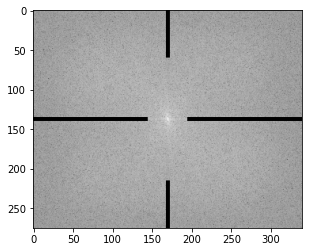

In [ ]:
#Using a notch filter on the fourier transform of each channel (setting the vertical and horizontal axes-except the centre as zero)
#As the central part has important information
#I adjusted the lengths and widths of the notch filter until the final image looked good and didnt have scan lines
arrq4gmasked=arrq4g.copy()
for i in range(135,140):
  for j in range(0,145):
      arrq4gmasked[i,j]=0.1
for i in range(135,140):
  for j in range(195,340):
      arrq4gmasked[i,j]=0.1
for i in range(0,60):
  for j in range(168,173):
      arrq4gmasked[i,j]=0.1
for i in range(215,275):
  for j in range(168,173):
      arrq4gmasked[i,j]=0.1
plt.imshow(np.log(abs(arrq4gmasked)), cmap='gray');


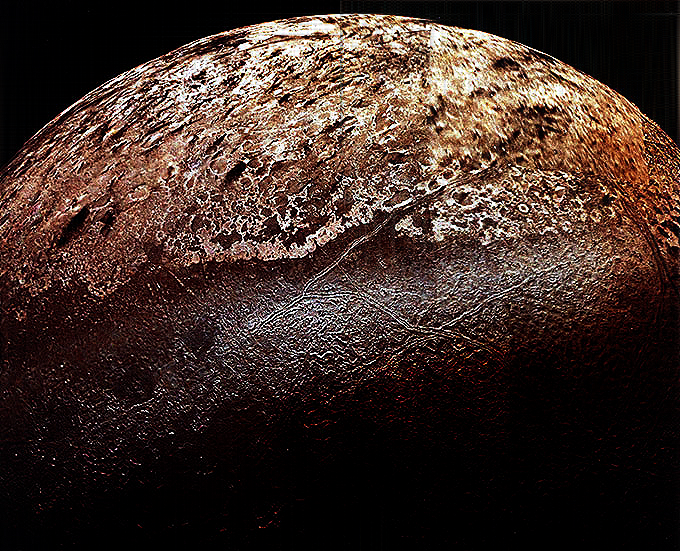

In [ ]:
#Taking inverse fourier transform
invq4r=(abs(np.fft.ifft2(arrq4rmasked)))
invq4b=(abs(np.fft.ifft2(arrq4bmasked)))
invq4g=(abs(np.fft.ifft2(arrq4gmasked)))

#Merging the three channels and displaying the image
for i in range(275):
  for j in range(340,680):
      image3d[i,j,0]=np.clip(invq4b[i,340-j],0,255)
      image3d[i,j,1]=np.clip(invq4g[i,340-j],0,255)
      image3d[i,j,2]=np.clip(invq4r[i,340-j],0,255)
cv2_imshow(image3d)

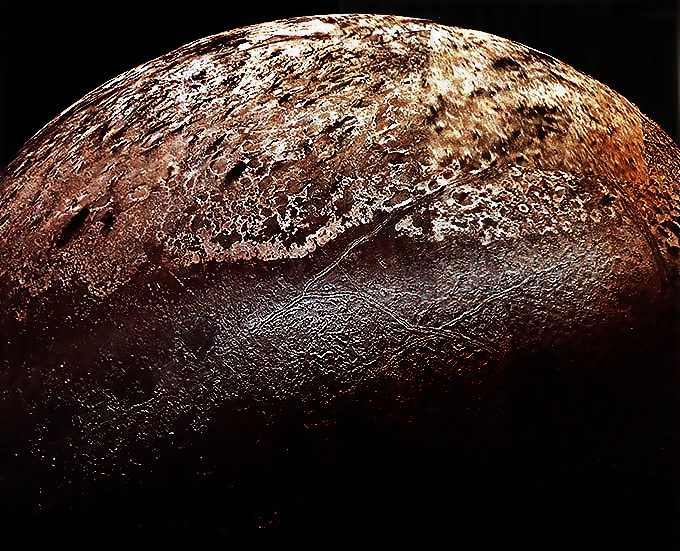

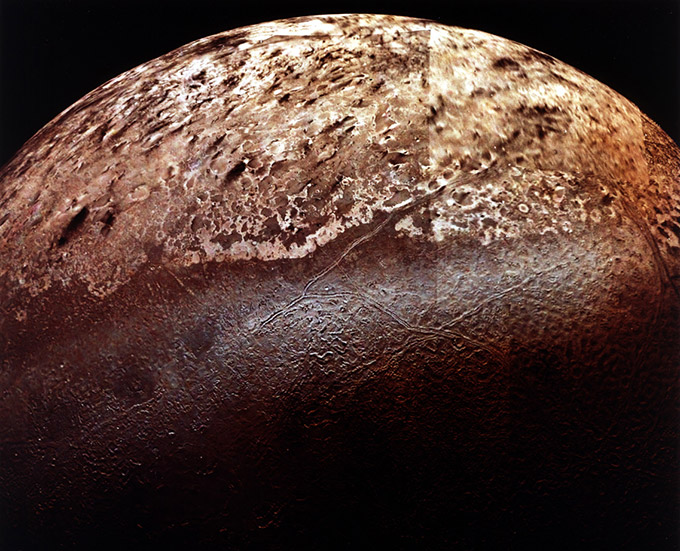

In [ ]:
#The image looks noisy and has some scan lines at the edges so applying a bilateral filter to smoothen it
blurrr = cv2.bilateralFilter(image3d,9,60,60)
cv2_imshow(blurrr)
cv2_imshow(image3)

First quadrant

In [ ]:
# image3eb=np.zeros((275,340), dtype=int)
# image3eg=np.zeros((275,340), dtype=int)
# image3er=np.zeros((275,340), dtype=int)

# for i in range(275):
#   for j in range(340):
#       image3eb[i,j]=image3a[i,j,0]
#       image3eg[i,j]=image3a[i,j,1]
#       image3er[i,j]=image3a[i,j,2]
# cv2_imshow(image3eb)
# cv2_imshow(image3eg)
# cv2_imshow(image3er)
# quad1rfourier = np.fft.fftshift(np.fft.fft2(image3er))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad1rfourier)), cmap='gray');
# quad1bfourier = np.fft.fftshift(np.fft.fft2(image3eb))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad1bfourier)), cmap='gray');
# quad1gfourier = np.fft.fftshift(np.fft.fft2(image3eg))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad1gfourier)), cmap='gray');
# arrq1r= np.asarray(quad1rfourier) 
# arrq1b= np.asarray(quad1bfourier) 
# arrq1g= np.asarray(quad1gfourier) 

In [ ]:
# arrq1rmasked=arrq1r.copy()
# for i in range(135,140):
#   for j in range(0,90):
#       arrq1rmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(250,340):
#       arrq1rmasked[i,j]=0.1
# for i in range(0,50):
#   for j in range(168,173):
#       arrq1rmasked[i,j]=0.1
# for i in range(225,275):
#   for j in range(168,173):
#       arrq1rmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq1rmasked)), cmap='gray');



In [ ]:
# arrq1gmasked=arrq1g.copy()
# for i in range(135,140):
#   for j in range(0,90):
#       arrq1gmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(250,340):
#       arrq1gmasked[i,j]=0.1
# for i in range(0,50):
#   for j in range(168,173):
#       arrq1gmasked[i,j]=0.1
# for i in range(225,275):
#   for j in range(168,173):
#       arrq1gmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq1gmasked)), cmap='gray');



In [ ]:
# arrq1bmasked=arrq1b.copy()
# for i in range(135,140):
#   for j in range(0,90):
#       arrq1bmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(250,340):
#       arrq1bmasked[i,j]=0.1
# for i in range(0,50):
#   for j in range(168,173):
#       arrq1bmasked[i,j]=0.1
# for i in range(225,275):
#   for j in range(168,173):
#       arrq1bmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq1bmasked)), cmap='gray');

In [ ]:
# invq1r=(abs(np.fft.ifft2(arrq1rmasked)))
# invq1b=(abs(np.fft.ifft2(arrq1bmasked)))
# invq1g=(abs(np.fft.ifft2(arrq1gmasked)))

# for i in range(275):
#   for j in range(340):
#       image3b[i,j,0]=np.clip(invq1b[i,j],0,255)
#       image3b[i,j,1]=np.clip(invq1g[i,j],0,255)
#       image3b[i,j,2]=np.clip(invq1r[i,j],0,255)
# cv2_imshow(image3b)


2nd Quadrant

In [ ]:
# image3fb=np.zeros((276,340), dtype=int)
# image3fg=np.zeros((276,340), dtype=int)
# image3fr=np.zeros((276,340), dtype=int)

# for i in range(275,551):
#   for j in range(340):
#       image3fb[275-i,j]=image3a[i,j,0]
#       image3fg[275-i,j]=image3a[i,j,1]
#       image3fr[275-i,j]=image3a[i,j,2]
# cv2_imshow(image3fb)
# cv2_imshow(image3fg)
# cv2_imshow(image3fr)

# quad2rfourier = np.fft.fftshift(np.fft.fft2(image3fr))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad2rfourier)), cmap='gray');
# quad2bfourier = np.fft.fftshift(np.fft.fft2(image3fb))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad2bfourier)), cmap='gray');
# quad2gfourier = np.fft.fftshift(np.fft.fft2(image3fg))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad2gfourier)), cmap='gray');
# arrq2r= np.asarray(quad2rfourier) 
# arrq2b= np.asarray(quad2bfourier) 
# arrq2g= np.asarray(quad2gfourier) 


In [ ]:
# arrq2rmasked=arrq2r.copy()
# for i in range(135,140):
#   for j in range(0,125):
#       arrq2rmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(220,340):
#       arrq2rmasked[i,j]=0.1
# for i in range(0,50):
#   for j in range(168,173):
#       arrq2rmasked[i,j]=0.1
# for i in range(225,276):
#   for j in range(168,173):
#       arrq2rmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq2rmasked)), cmap='gray');


In [ ]:
# arrq2gmasked=arrq2g.copy()
# for i in range(135,140):
#   for j in range(0,125):
#       arrq2gmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(220,340):
#       arrq2gmasked[i,j]=0.1
# for i in range(0,50):
#   for j in range(168,173):
#       arrq2gmasked[i,j]=0.1
# for i in range(225,276):
#   for j in range(168,173):
#       arrq2gmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq2gmasked)), cmap='gray');

In [ ]:
# arrq2bmasked=arrq2b.copy()
# for i in range(135,140):
#   for j in range(0,125):
#       arrq2bmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(220,340):
#       arrq2bmasked[i,j]=0.1
# for i in range(0,50):
#   for j in range(168,173):
#       arrq2bmasked[i,j]=0.1
# for i in range(225,276):
#   for j in range(168,173):
#       arrq2bmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq2bmasked)), cmap='gray');

In [ ]:
# invq2r=(abs(np.fft.ifft2(arrq2rmasked)))
# invq2b=(abs(np.fft.ifft2(arrq2bmasked)))
# invq2g=(abs(np.fft.ifft2(arrq2gmasked)))

# for i in range(275,551):
#   for j in range(340):
#       image3b[i,j,0]=np.clip(invq2b[275-i,j],0,255)
#       image3b[i,j,1]=np.clip(invq2g[275-i,j],0,255)
#       image3b[i,j,2]=np.clip(invq2r[275-i,j],0,255)
# cv2_imshow(image3b)


3rd Quadrant

In [ ]:
# image3gb=np.zeros((276,340), dtype=int)
# image3gg=np.zeros((276,340), dtype=int)
# image3gr=np.zeros((276,340), dtype=int)

# for i in range(275,551):
#   for j in range(340,680):
#       image3gb[275-i,340-j]=image3a[i,j,0]
#       image3gg[275-i,340-j]=image3a[i,j,1]
#       image3gr[275-i,340-j]=image3a[i,j,2]
# cv2_imshow(image3gb)
# cv2_imshow(image3gg)
# cv2_imshow(image3gr)

# quad3rfourier = np.fft.fftshift(np.fft.fft2(image3gr))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad3rfourier)), cmap='gray');
# quad3bfourier = np.fft.fftshift(np.fft.fft2(image3gb))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad3bfourier)), cmap='gray');
# quad3gfourier = np.fft.fftshift(np.fft.fft2(image3gg))
# plt.figure(num=None, figsize=(8, 6), dpi=80)
# plt.imshow(np.log(abs(quad3gfourier)), cmap='gray');
# arrq3r= np.asarray(quad3rfourier) 
# arrq3b= np.asarray(quad3bfourier) 
# arrq3g= np.asarray(quad3gfourier) 


In [ ]:
# arrq3rmasked=arrq3r.copy()
# for i in range(135,140):
#   for j in range(0,160):
#       arrq3rmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(180,340):
#       arrq3rmasked[i,j]=0.1
# for i in range(0,25):
#   for j in range(168,173):
#       arrq3rmasked[i,j]=0.1
# for i in range(250,276):
#   for j in range(168,173):
#       arrq3rmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq3rmasked)), cmap='gray');


In [ ]:
# arrq3gmasked=arrq3g.copy()
# for i in range(135,140):
#   for j in range(0,160):
#       arrq3gmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(180,340):
#       arrq3gmasked[i,j]=0.1
# for i in range(0,25):
#   for j in range(168,173):
#       arrq3gmasked[i,j]=0.1
# for i in range(250,276):
#   for j in range(168,173):
#       arrq3gmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq3gmasked)), cmap='gray');

In [ ]:
# arrq3bmasked=arrq3b.copy()
# for i in range(135,140):
#   for j in range(0,160):
#       arrq3bmasked[i,j]=0.1
# for i in range(135,140):
#   for j in range(180,340):
#       arrq3bmasked[i,j]=0.1
# for i in range(0,25):
#   for j in range(168,173):
#       arrq3bmasked[i,j]=0.1
# for i in range(250,276):
#   for j in range(168,173):
#       arrq3bmasked[i,j]=0.1
# plt.imshow(np.log(abs(arrq3bmasked)), cmap='gray');

In [ ]:
# invq3r=(abs(np.fft.ifft2(arrq3rmasked)))
# invq3b=(abs(np.fft.ifft2(arrq3bmasked)))
# invq3g=(abs(np.fft.ifft2(arrq3gmasked)))

# for i in range(275,551):
#   for j in range(340,680):
#       image3b[i,j,0]=np.clip(invq3b[275-i,340-j],0,255)
#       image3b[i,j,1]=np.clip(invq3g[275-i,340-j],0,255)
#       image3b[i,j,2]=np.clip(invq3r[275-i,340-j],0,255)
# cv2_imshow(image3b)


# d)  A picture of a car blurred due to the relative motion of the camera is given at https://www.ee.iitb.ac.in/~asethi/Dump/MakeNumberPlateReadable.jpg. Restore and enhance the pictureto reveal the numbers and letters on the number (license) plate. [3]

Reference: http://www.cse.cuhk.edu.hk/~leojia/projects/robust_deblur/

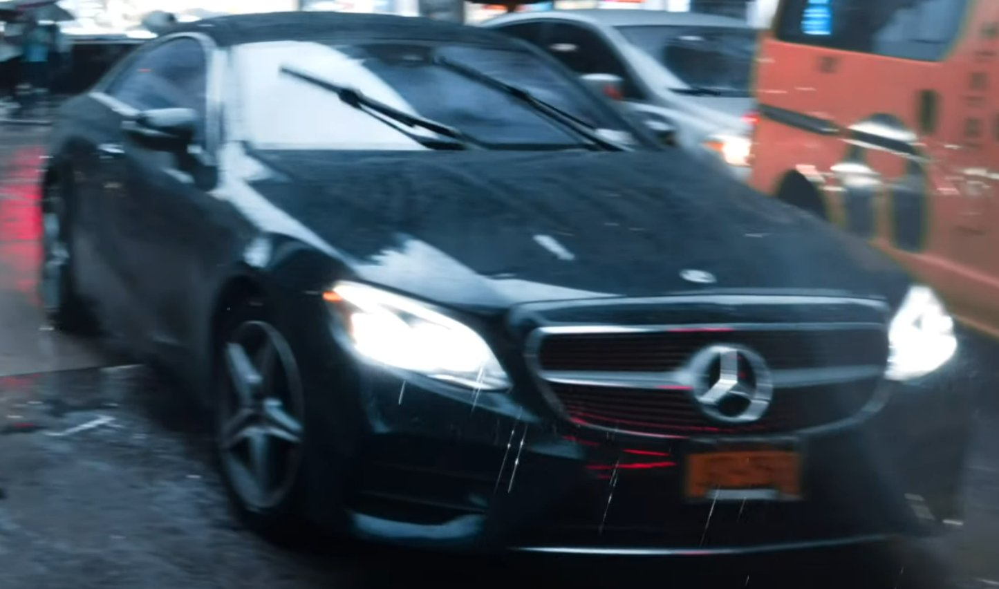

In [ ]:
#Reading the image from drive
image4=cv2.imread('/content/drive/MyDrive/ee610_ass1/MakeNumberPlateReadable.jpg')
from google.colab.patches import cv2_imshow
#Displaying the waterfall color image
cv2_imshow(image4)
#making copies of the image for using further
image4a=image4.copy()
image4b=image4.copy()
image4c=image4.copy()
image4d=image4.copy()


In [ ]:
#Printing its shape
print(image4.shape)

(852, 1445, 3)


In [ ]:
#We want to find the size of the blur kernel.
#For this, I looked at the centre point of the mercedes logo to see how much it has moved
#I cropped the image unil i could extract the exact motion path of that point
image4crop=image4[548:555,1040:1067,:]
cv2_imshow(image4crop)
#Ad we can see, it is 27 pixels long and about 6 pixels wide

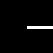

In [ ]:
#We want to generate a blur kernel that will blur the image horizontally over a length of 27 pixels.
#At first, I did this by using a 27*27 kernel with a horizontal line at its centre to blur the image
#However, we can also see that the image has been blurred only to its right, not left.
#So I retried with a 53*53 kernel, with a horizontal line from its centre to its right end, 3 pixels thick. 
#This will give a horizontal blurring effect to the left.

kernel=np.zeros((53,53),dtype=float)

# kernel[22,0]=0.032
# kernel[22,1]=0.032
# kernel[22,2]=0.032
# kernel[22,3]=0.032
# kernel[22,4]=0.032
# kernel[22,5]=0.032

# kernel[23,5]=0.032
# kernel[23,6]=0.032
# kernel[23,7]=0.032
# kernel[23,8]=0.032
# kernel[23,9]=0.032
# kernel[23,10]=0.032

# kernel[24,10]=0.032
# kernel[24,11]=0.032
# kernel[24,12]=0.032
# kernel[24,13]=0.032
# kernel[24,14]=0.032
# kernel[24,15]=0.032

# kernel[25,15]=0.032
# kernel[25,16]=0.032
# kernel[25,17]=0.032
# kernel[25,18]=0.032
# kernel[25,19]=0.032
# kernel[25,20]=0.032

# kernel[26,20]=0.032
# kernel[26,21]=0.032
# kernel[26,22]=0.032
# kernel[26,23]=0.032
# kernel[26,24]=0.032
# kernel[26,25]=0.032
# kernel[26,26]=0.032

#The sum of all values in the kernel must be 1
for j in range(27,53):
  for i in range(26,29):
    kernel[i,j]=0.0129
#Multiplying by a value for visibility purposes so that the pizels get scaled to 255
cv2_imshow(kernel*19921)


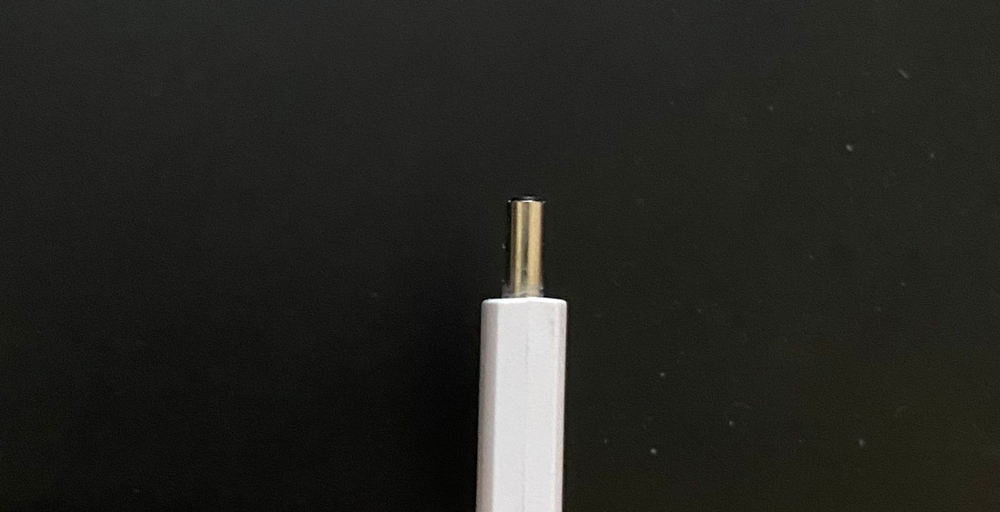

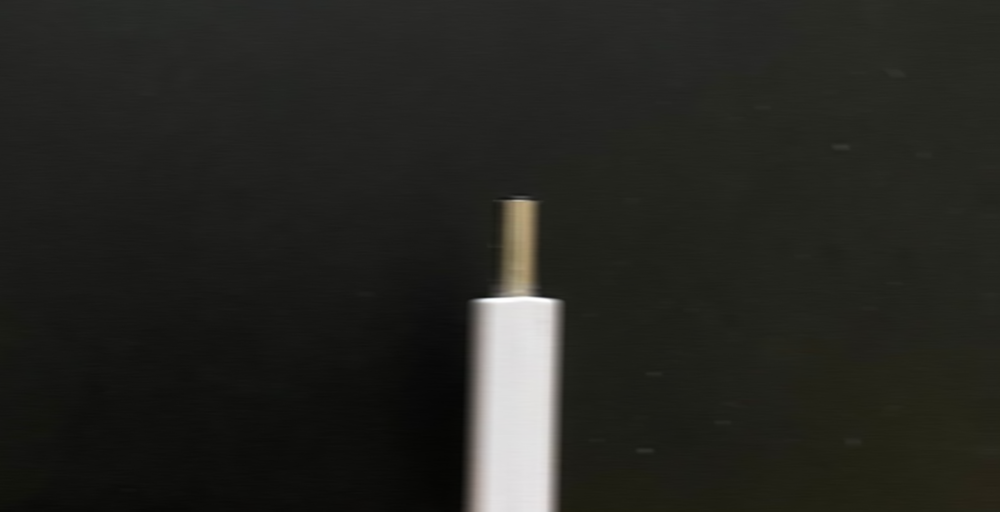

In [ ]:
#I used a test image that I clicked to view the blurring effect of my kernel
image5=cv2.imread('/content/drive/MyDrive/ee610_ass1/trial.jpeg')
from google.colab.patches import cv2_imshow
#Displaying the waterfall color image
cv2_imshow(image5)
image5 = cv2.filter2D(image5,-1, kernel)
cv2_imshow(image5)
#We can see that it givs a very similar effect to the blur of the car
#So this is a good kernel to use for applying a weiner filter for cleaning the blur

To deblur, I used the weiner filter.

In [ ]:
#Taking fourier transform of the kernel
w=np.fft.fft2(kernel,s=[852,1445])
print(w.shape)

(852, 1445)


In [ ]:
#Taking conjugate of the fourier transform of the kernel
wstar=np.conjugate(w)
print(wstar.shape)

(852, 1445)


In [ ]:
#Computing the absolute value of the fourier transform of the kernel and squaring it
det=np.abs(w)
print(det.shape)
det=det**2

(852, 1445)


In [ ]:
#Formula for the denominator of the weiner filter. 
#I varied k to find an ideal value of 0.6
den= det+0.6

In [ ]:
#Formula for the weiner filter
weiner=wstar/den

In [ ]:
#Separating the image into blue, green and red channels
image4bl=np.zeros((852,1445), dtype=int)
image4gr=np.zeros((852,1445), dtype=int)
image4re=np.zeros((852,1445), dtype=int)
for i in range(852):
  for j in range(1445):
      image4bl[i,j]=image4c[i,j,0]
      image4gr[i,j]=image4c[i,j,1]
      image4re[i,j]=image4c[i,j,2]

In [ ]:
#Taking fourier transform of each channel
refou=np.fft.fft2(image4re)
blfou=np.fft.fft2(image4bl)
grfou=np.fft.fft2(image4gr)

In [ ]:
#Convolving the image with the weiner filter is equivalent to multiplying its fft with the fourier version of the weiner filter (channel wise)
renew=refou*weiner
blnew=blfou*weiner
grnew=grfou*weiner

In [ ]:
#Taking Inverse fourier transform of each channel
re=abs(np.fft.ifft2(renew))
bl=abs(np.fft.ifft2(blnew))
gr=abs(np.fft.ifft2(grnew))

In [ ]:
#Merging channels
for i in range (852):
  for j in range(1445):
    image4d[i,j,0]=bl[i,j] 
    image4d[i,j,1]=gr[i,j]
    image4d[i,j,2]=re[i,j]
#Trying to increase contrast by multiplying with a constant as the image was slightly dull
image4d=image4d*1.5

In [ ]:
#After weiner fltering, the image is slightly less blurred and the numbers more visible
cv2_imshow(image4d)
cv2_imshow(image4a)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#Gamma transform using different gammas to enhance the image.. and concluded that gamma=1.3 is the best
print ('gamma=1.5')
for i in range(852):
  for j in range(1445):
    for k in range(3):
      image4d[i,j,k]=(image4d[i,j,k]**1.3)/5.28
#This made the image a little dark so brightening it by adding a value to each pixel
for i in range(852):
  for j in range(1445):
    for k in range(3):
      image4d[i,j,k]=(image4d[i,j,k]+10)


gamma=1.5


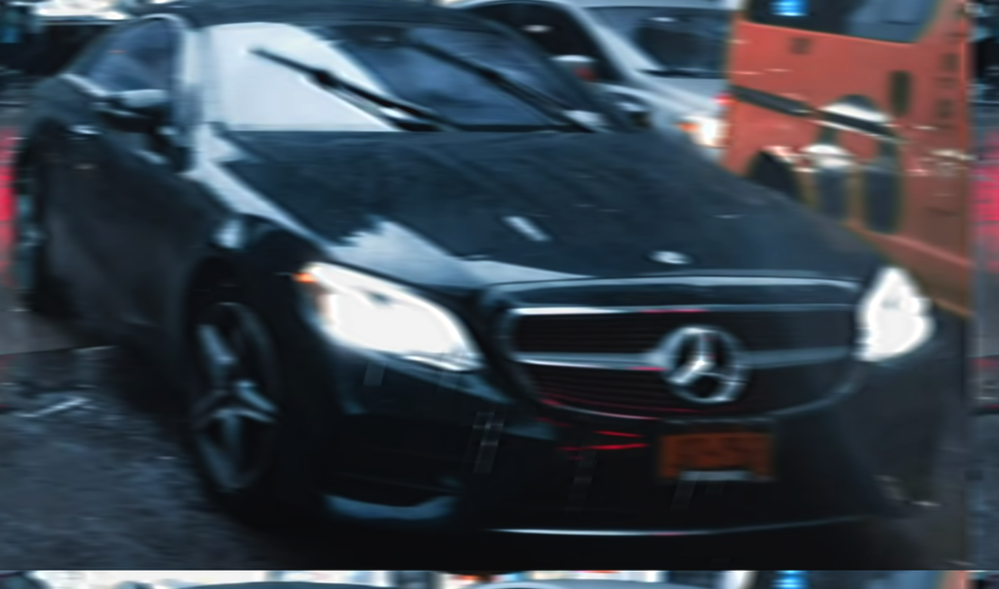

In [ ]:
cv2_imshow(image4d)
#Displaying the image

In [ ]:
#Using a sharpening kernel to sharpen the numberplate lines
kernely = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
image4d = cv2.filter2D(image4d, -1, kernely)
cv2_imshow(image4d)


Output hidden; open in https://colab.research.google.com to view.

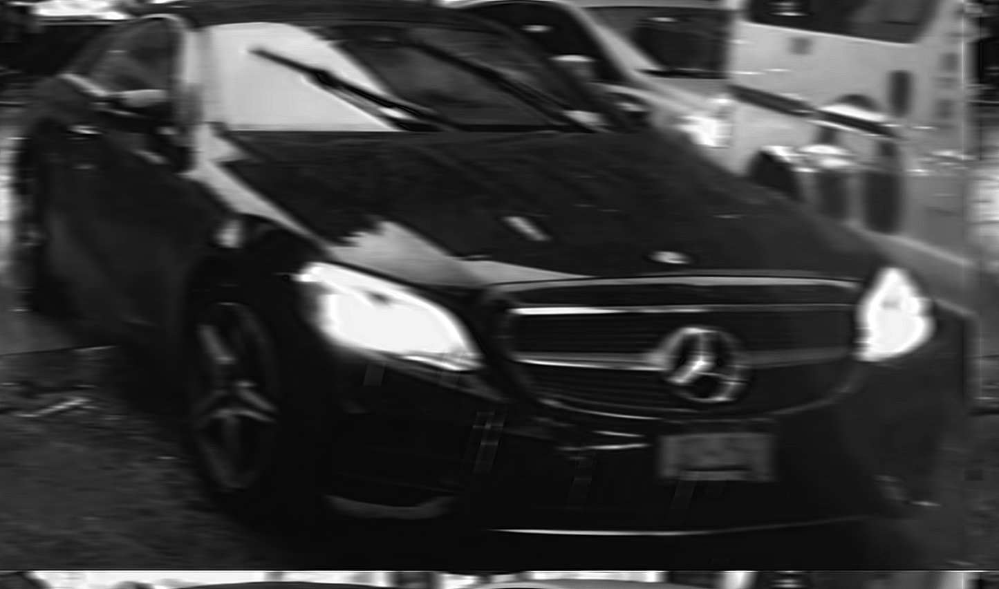

In [ ]:
#We can see some periodic horizontal lines, that might be removed using the fourier transform
image4bl=np.zeros((852,1445), dtype=int)
image4gr=np.zeros((852,1445), dtype=int)
image4re=np.zeros((852,1445), dtype=int)
#Separating the image into 3 channels
for i in range(852):
  for j in range(1445):
      image4bl[i,j]=image4d[i,j,0]
      image4gr[i,j]=image4d[i,j,1]
      image4re[i,j]=image4d[i,j,2]
#Since the numberplate was red, i wanted to see if the red channel would be any clearer as the numberplate pixels would be of higher intensity in that channel and the numbers would be of lower intensity
cv2_imshow(image4re)
#But this looks just as blurred as the image

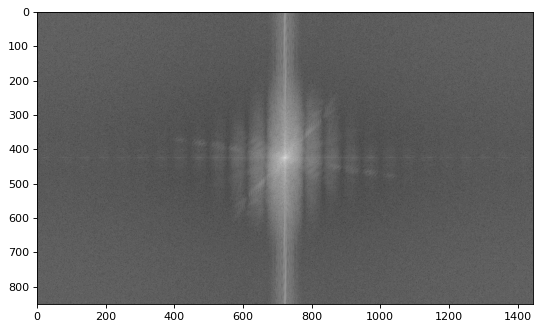

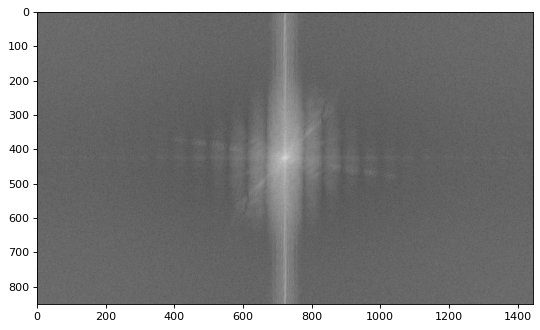

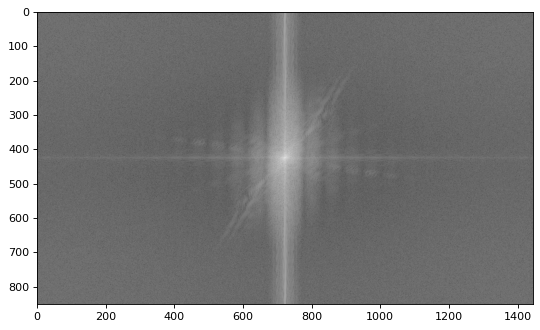

In [ ]:
#Taking channel wise fourier tranform, we can see some periodic vertical lines. We will try to remove those using a low pass filter
fourierb = np.fft.fftshift(np.fft.fft2(image4bl))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(fourierb)), cmap='gray');
fourierg = np.fft.fftshift(np.fft.fft2(image4gr))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(fourierg)), cmap='gray');
fourierr = np.fft.fftshift(np.fft.fft2(image4re))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(fourierr)), cmap='gray');

In [ ]:
#Saving the fourier transforms as arrays
arrb=np.asarray(fourierb)
arrg=np.asarray(fourierg)
arrr=np.asarray(fourierr)

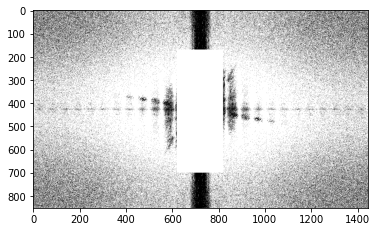

In [ ]:
#Creating a low pass filter mask(same method as q2)
bmask=arrb.copy()
logarr= np.log(abs(fourierb))
final=arrb.copy()
for i in range(0,170):
  for j in range(1445):
    if logarr[i,j]>8:
      bmask[i,j]=0.001
    else:
      bmask[i,j]=1
for i in range(170,700):
  for j in range(620):
    if logarr[i,j]>8:
      bmask[i,j]=0.001
    else:
      bmask[i,j]=1
for i in range(170,700):
  for j in range(620,820):
     bmask[i,j]=1 
for i in range(170,700):
  for j in range(820,1445):
    if logarr[i,j]>8:
      bmask[i,j]=0.001
    else:
      bmask[i,j]=1
for i in range(700,852):
  for j in range(1445):
    if logarr[i,j]>8:
      bmask[i,j]=0.001
    else:
      bmask[i,j]=1
plt.imshow(np.log(abs(bmask)), cmap='gray');

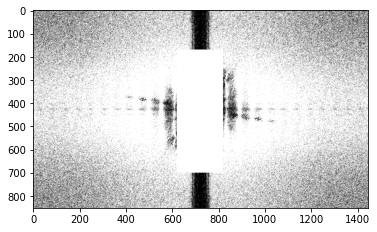

In [ ]:
#Creating a low pass filter mask(same method as q2)
gmask=arrg.copy()
logarr= np.log(abs(fourierg))
final=arrg.copy()
for i in range(0,170):
  for j in range(1445):
    if logarr[i,j]>8:
      gmask[i,j]=0.001
    else:
      gmask[i,j]=1
for i in range(170,700):
  for j in range(620):
    if logarr[i,j]>8:
      gmask[i,j]=0.001
    else:
      gmask[i,j]=1
for i in range(170,700):
  for j in range(620,820):
     gmask[i,j]=1 
for i in range(170,700):
  for j in range(820,1445):
    if logarr[i,j]>8:
      gmask[i,j]=0.001
    else:
      gmask[i,j]=1
for i in range(700,852):
  for j in range(1445):
    if logarr[i,j]>8:
      gmask[i,j]=0.001
    else:
      gmask[i,j]=1
plt.imshow(np.log(abs(gmask)), cmap='gray');

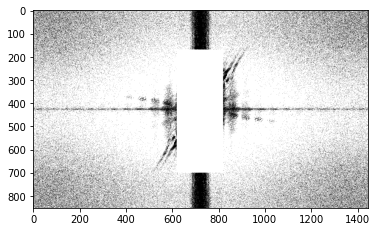

In [ ]:
#Creating a low pass filter mask(same method as q2)
rmask=arrr.copy()
logarr= np.log(abs(fourierr))
final=arrr.copy()
for i in range(0,170):
  for j in range(1445):
    if logarr[i,j]>8:
      rmask[i,j]=0.001
    else:
      rmask[i,j]=1
for i in range(170,700):
  for j in range(620):
    if logarr[i,j]>8:
      rmask[i,j]=0.001
    else:
      rmask[i,j]=1
for i in range(170,700):
  for j in range(620,820):
     rmask[i,j]=1 
for i in range(170,700):
  for j in range(820,1445):
    if logarr[i,j]>8:
      rmask[i,j]=0.001
    else:
      rmask[i,j]=1
for i in range(700,852):
  for j in range(1445):
    if logarr[i,j]>8:
      rmask[i,j]=0.001
    else:
      rmask[i,j]=1
plt.imshow(np.log(abs(rmask)), cmap='gray');

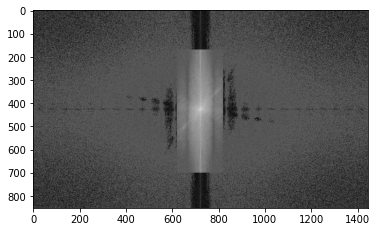

In [ ]:
#Applying the low pass filter mask(same method as q2)
for i in range(852):
  for j in range(1445):
    arrb[i,j]=arrb[i,j]*bmask[i,j]
plt.imshow(np.log(abs(arrb)), cmap='gray');

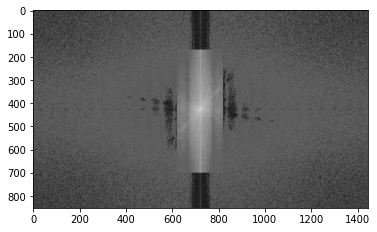

In [ ]:
#Applying the low pass filter mask(same method as q2)
for i in range(852):
  for j in range(1445):
    arrg[i,j]=arrg[i,j]*gmask[i,j]
plt.imshow(np.log(abs(arrg)), cmap='gray');

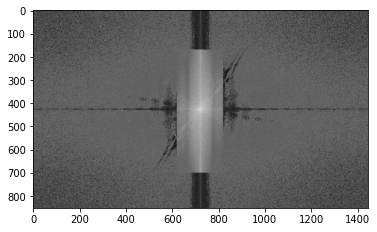

In [ ]:
#Applying the low pass filter mask(same method as q2)
for i in range(852):
  for j in range(1445):
    arrr[i,j]=arrr[i,j]*rmask[i,j]
plt.imshow(np.log(abs(arrr)), cmap='gray');

In [ ]:
#Taking inverse fourier transform
r=abs(np.fft.ifft2(arrr))
b=abs(np.fft.ifft2(arrb))
g=abs(np.fft.ifft2(arrg))


In [ ]:
#Merging channels ans displaying images
for i in range (852):
  for j in range(1445):
    image4b[i,j,0]=np.clip(b[i,j],0,255)
    image4b[i,j,1]=np.clip(g[i,j],0,255)
    image4b[i,j,2]=np.clip(r[i,j],0,255)
cv2_imshow(image4b)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#Trying to apply another smaller 26*26 kernel weiner filter to deblur some more
kernel=np.zeros((27,27),dtype=float)
for j in range(27):
  for i in range(13,14):
    kernel[i,j]=0.037
cv2_imshow(kernel*6891)
w=np.fft.fft2(kernel,s=[852,1445])
print(w.shape)
wstar=np.conjugate(w)
print(wstar.shape)
det=np.abs(w)
print(det.shape)
det=det**2
den= det+0.6
weiner=wstar/den
image4bl=np.zeros((852,1445), dtype=int)
image4gr=np.zeros((852,1445), dtype=int)
image4re=np.zeros((852,1445), dtype=int)
for i in range(852):
  for j in range(1445):
      image4bl[i,j]=image4b[i,j,0]
      image4gr[i,j]=image4b[i,j,1]
      image4re[i,j]=image4b[i,j,2]
refou=np.fft.fft2(image4re)
blfou=np.fft.fft2(image4bl)
grfou=np.fft.fft2(image4gr)
renew=refou*weiner
blnew=blfou*weiner
grnew=grfou*weiner
re=abs(np.fft.ifft2(renew))
bl=abs(np.fft.ifft2(blnew))
gr=abs(np.fft.ifft2(grnew))
for i in range (852):
  for j in range(1445):
    image4d[i,j,0]=bl[i,j]
    image4d[i,j,1]=gr[i,j]
    image4d[i,j,2]=re[i,j]
image4d=image4d*1.5
cv2_imshow(image4d)
cv2_imshow(image4a)
#But this image is more blurred than the previous one

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
print('Best image')
cv2_imshow(image4b)
#So the final best image I chose was the one after fourier transform.

Output hidden; open in https://colab.research.google.com to view.

We can read '5452' on the number plate

# e) ML-based image restoration:

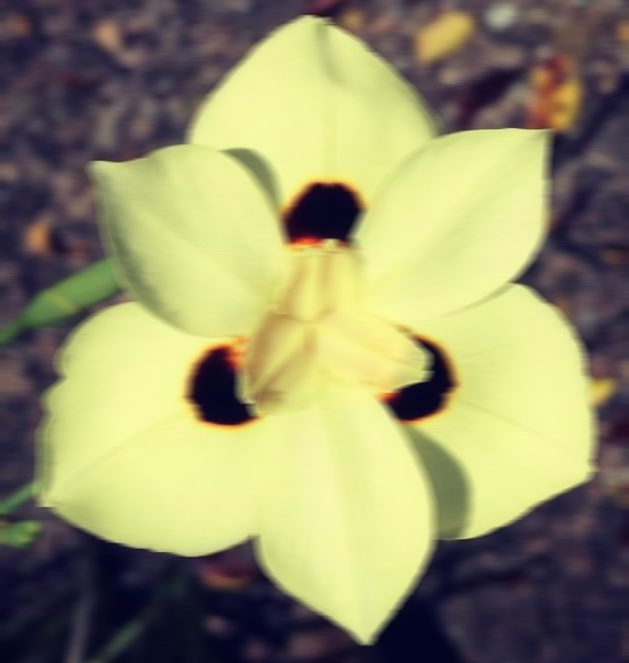

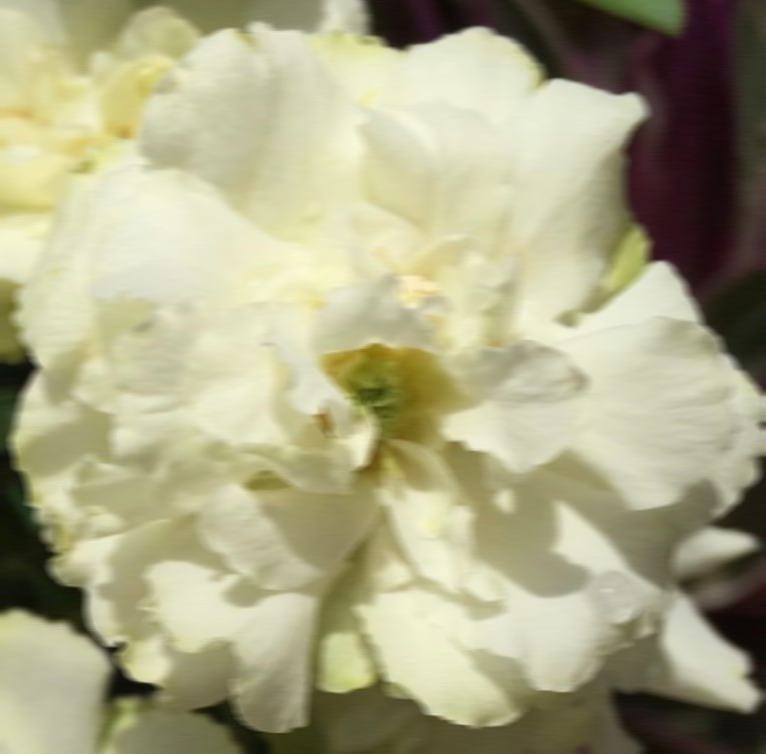

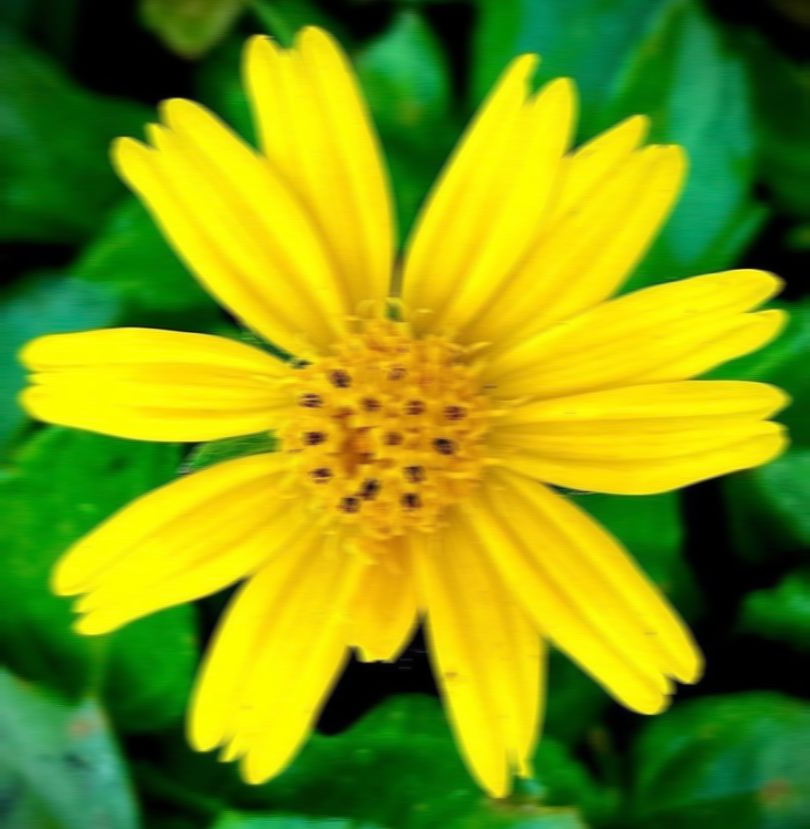

In [ ]:
#Reading the images from drive
image6a=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow1.jpeg')
image6b=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow2.jpeg')
image6c=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow3.jpeg')
image6d=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow4.jpeg')
image6e=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow5.jpeg')
image6f=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow6.jpeg')
image6g=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow7.jpeg')
image6h=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow8.jpeg')
image6i=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow9.jpeg')
image6j=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow10.jpeg')
image7a=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow11.png')
image7b=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow12.png')
image7c=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow13.png')

#Displaying blurred images
from google.colab.patches import cv2_imshow
cv2_imshow(image7a)
cv2_imshow(image7b)
cv2_imshow(image7c)

All images are front pictures of flowers with a dark, blurry background. The degraded images are horizontally blurred.

I will add a similar horizontal blur to the sharp images

In [ ]:
#Displaying some of the images
cv2_imshow(image6a)
cv2_imshow(image6b)
cv2_imshow(image6c)
cv2_imshow(image6d)
cv2_imshow(image6e)
cv2_imshow(image6f)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#Blur kernel for horizontal blur.. chose a 13*13 kernel with a horizontal line in the centre
kernel=np.zeros((13,13),dtype=float)
#The sum of all values in the kernel must be 1
for j in range(13):
  for i in range(6,7):
    kernel[i,j]=0.0769
#Multiplying by a value for visibility purposes so that the pixels get scaled to 255
cv2_imshow(kernel*3315)


In [ ]:
#Blurring all training images
image8a = cv2.filter2D(image6a,-1, kernel)
image8b = cv2.filter2D(image6b,-1, kernel)
image8c = cv2.filter2D(image6c,-1, kernel)
image8d = cv2.filter2D(image6d,-1, kernel)
image8e = cv2.filter2D(image6e,-1, kernel)
image8f = cv2.filter2D(image6f,-1, kernel)
image8g = cv2.filter2D(image6g,-1, kernel)
image8h = cv2.filter2D(image6h,-1, kernel)
image8i = cv2.filter2D(image6i,-1, kernel)
image8j = cv2.filter2D(image6j,-1, kernel)


In [ ]:
#Making a validation set
image9a=image6i.copy()
image9b=image6j.copy()
image10a=image8i.copy()
image10b=image8j.copy()

In [ ]:
image9c=cv2.imread('/content/drive/MyDrive/ee610_ass1/flow14.jpeg')
image10c = cv2.filter2D(image9c,-1, kernel)


Training: Good images= image6a to h

Training: Bad images= image8a to h

Validation: Good images= image9a to c

Validation: Bad images= image10a to c

Test: Image7a to c

In [ ]:
#Printing the shapes of images to iterate over them
print(image8a.shape)
print(image8b.shape)
print(image8c.shape)
print(image8d.shape)
print(image8e.shape)
print(image8f.shape)
print(image8g.shape)
print(image8h.shape)

(881, 828, 3)
(657, 652, 3)
(788, 740, 3)
(793, 745, 3)
(818, 828, 3)
(925, 827, 3)
(821, 787, 3)
(805, 761, 3)


In [ ]:
#Setting the size of the kernel.Size=2a+1
a=13

In [ ]:
from sklearn.feature_extraction import image
#for image8a
#Array to store patches of degraded image
patchesb=[]
patchesg=[]
patchesr=[]
#Array to store central pixel or original image
centreb=[]
centreg=[]
centrer=[]
#We take 125 patches for each image
for i in range(125):
  #Here we select a random point in the image,slightly away from the border as the central pixel
     k=np.random.randint(50, 800, size=None, dtype=int)
     l=np.random.randint(50, 750, size=None, dtype=int)
     b=image6a[k,l,0]
     g=image6a[k,l,1]
     r=image6a[k,l,2]
     #We store this pixel from the original image into our centre array
     centreb.append(b)
     centreg.append(g)
     centrer.append(r)
     #We take a patch of 2a+1*2a+1 around it
     patb=image8a[k-a:k+a+1,l-a:l+a+1,0]
     patg=image8a[k-a:k+a+1,l-a:l+a+1,1]
     patr=image8a[k-a:k+a+1,l-a:l+a+1,2]
     #We flatten this patch
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     #And append it to our patch array
     patchesb.append(patflatb)
     patchesg.append(patflatg)
     patchesr.append(patflatr)
#All of these steps are done differently for each channel as we will make a separate model for each channel

In [ ]:
#Exact same method used for the rest of the training images
for i in range(125):
     k=np.random.randint(50, 600, size=None, dtype=int)
     l=np.random.randint(50, 600, size=None, dtype=int)
     b=image6b[k,l,0]
     g=image6b[k,l,1]
     r=image6b[k,l,2]
     centreb.append(b)
     centreg.append(g)
     centrer.append(r)
     patb=image8b[k-a:k+a+1,l-a:l+a+1,0]
     patg=image8b[k-a:k+a+1,l-a:l+a+1,1]
     patr=image8b[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesb.append(patflatb)
     patchesg.append(patflatg)
     patchesr.append(patflatr)
for i in range(125):
     k=np.random.randint(50, 700, size=None, dtype=int)
     l=np.random.randint(50, 650, size=None, dtype=int)
     b=image6c[k,l,0]
     g=image6c[k,l,1]
     r=image6c[k,l,2]
     centreb.append(b)
     centreg.append(g)
     centrer.append(r)
     patb=image8c[k-a:k+a+1,l-a:l+a+1,0]
     patg=image8c[k-a:k+a+1,l-a:l+a+1,1]
     patr=image8c[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesb.append(patflatb)
     patchesg.append(patflatg)
     patchesr.append(patflatr)



In [ ]:
for i in range(125):
     k=np.random.randint(50, 700, size=None, dtype=int)
     l=np.random.randint(50, 650, size=None, dtype=int)
     b=image6d[k,l,0]
     g=image6d[k,l,1]
     r=image6d[k,l,2]
     centreb.append(b)
     centreg.append(g)
     centrer.append(r)
     patb=image8d[k-a:k+a+1,l-a:l+a+1,0]
     patg=image8d[k-a:k+a+1,l-a:l+a+1,1]
     patr=image8d[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesb.append(patflatb)
     patchesg.append(patflatg)
     patchesr.append(patflatr)
for i in range(125):
     k=np.random.randint(50, 750, size=None, dtype=int)
     l=np.random.randint(50, 750, size=None, dtype=int)
     b=image6e[k,l,0]
     g=image6e[k,l,1]
     r=image6e[k,l,2]
     centreb.append(b)
     centreg.append(g)
     centrer.append(r)
     patb=image8e[k-a:k+a+1,l-a:l+a+1,0]
     patg=image8e[k-a:k+a+1,l-a:l+a+1,1]
     patr=image8e[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesb.append(patflatb)
     patchesg.append(patflatg)
     patchesr.append(patflatr)
for i in range(125):
     k=np.random.randint(50, 850, size=None, dtype=int)
     l=np.random.randint(50, 750, size=None, dtype=int)
     b=image6f[k,l,0]
     g=image6f[k,l,1]
     r=image6f[k,l,2]
     centreb.append(b)
     centreg.append(g)
     centrer.append(r)
     patb=image8f[k-a:k+a+1,l-a:l+a+1,0]
     patg=image8f[k-a:k+a+1,l-a:l+a+1,1]
     patr=image8f[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesb.append(patflatb)
     patchesg.append(patflatg)
     patchesr.append(patflatr)
for i in range(125):
     k=np.random.randint(50, 750, size=None, dtype=int)
     l=np.random.randint(50, 700, size=None, dtype=int)
     b=image6g[k,l,0]
     g=image6g[k,l,1]
     r=image6g[k,l,2]
     centreb.append(b)
     centreg.append(g)
     centrer.append(r)
     patb=image8g[k-a:k+a+1,l-a:l+a+1,0]
     patg=image8g[k-a:k+a+1,l-a:l+a+1,1]
     patr=image8g[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesb.append(patflatb)
     patchesg.append(patflatg)
     patchesr.append(patflatr)
for i in range(125):
     k=np.random.randint(50, 750, size=None, dtype=int)
     l=np.random.randint(50, 700, size=None, dtype=int)
     b=image6h[k,l,0]
     g=image6h[k,l,1]
     r=image6h[k,l,2]
     centreb.append(b)
     centreg.append(g)
     centrer.append(r)
     patb=image8h[k-a:k+a+1,l-a:l+a+1,0]
     patg=image8h[k-a:k+a+1,l-a:l+a+1,1]
     patr=image8h[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesb.append(patflatb)
     patchesg.append(patflatg)
     patchesr.append(patflatr)

In [ ]:
#Converting the centre table and the patch table into arrays and checking their shape(for each channel)
patchesb=np.asarray(patchesb)
centreb=np.asarray(centreb)
print(centreb.shape)
print(patchesb.shape)
patchesg=np.asarray(patchesg)
centreg=np.asarray(centreg)
print(centreg.shape)
print(patchesg.shape)
patchesr=np.asarray(patchesr)
centrer=np.asarray(centrer)
print(centrer.shape)
print(patchesr.shape)

(1000,)
(1000, 729)
(1000,)
(1000, 729)
(1000,)
(1000, 729)


Training data has 1000 entries. Validation data will have 375 entries.

In [ ]:
print(image9a.shape)
print(image9b.shape)
print(image9c.shape)

(507, 531, 3)
(758, 791, 3)
(566, 828, 3)


In [ ]:
#Same procedure to make patches of validation images
patchesvalr=[]
centrevalr=[]
patchesvalb=[]
centrevalb=[]
patchesvalg=[]
centrevalg=[]
for i in range(125):
     k=np.random.randint(50, 450, size=None, dtype=int)
     l=np.random.randint(50, 450, size=None, dtype=int)
     b=image9a[k,l,0]
     g=image9a[k,l,1]
     r=image9a[k,l,2]
     centrevalb.append(b)
     centrevalg.append(g)
     centrevalr.append(r)
     patb=image10a[k-a:k+a+1,l-a:l+a+1,0]
     patg=image10a[k-a:k+a+1,l-a:l+a+1,1]
     patr=image10a[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesvalb.append(patflatb)
     patchesvalg.append(patflatg)
     patchesvalr.append(patflatr)
for i in range(125):
     k=np.random.randint(50, 700, size=None, dtype=int)
     l=np.random.randint(50, 700, size=None, dtype=int)
     b=image9b[k,l,0]
     g=image9b[k,l,1]
     r=image9b[k,l,2]
     centrevalb.append(b)
     centrevalg.append(g)
     centrevalr.append(r)
     patb=image10b[k-a:k+a+1,l-a:l+a+1,0]
     patg=image10b[k-a:k+a+1,l-a:l+a+1,1]
     patr=image10b[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesvalb.append(patflatb)
     patchesvalg.append(patflatg)
     patchesvalr.append(patflatr)
for i in range(125):
     k=np.random.randint(50, 500, size=None, dtype=int)
     l=np.random.randint(50, 750, size=None, dtype=int)
     b=image9c[k,l,0]
     g=image9c[k,l,1]
     r=image9c[k,l,2]
     centrevalb.append(b)
     centrevalg.append(g)
     centrevalr.append(r)
     patb=image10c[k-a:k+a+1,l-a:l+a+1,0]
     patg=image10c[k-a:k+a+1,l-a:l+a+1,1]
     patr=image10c[k-a:k+a+1,l-a:l+a+1,2]
     patflatb=np.ravel(patb)
     patflatg=np.ravel(patg)
     patflatr=np.ravel(patr)
     patchesvalb.append(patflatb)
     patchesvalg.append(patflatg)
     patchesvalr.append(patflatr)
#and print the array shapes
patchesvalb=np.asarray(patchesvalb)
print(patchesvalb.shape)
patchesvalg=np.asarray(patchesvalg)
print(patchesvalg.shape)
patchesvalr=np.asarray(patchesvalr)
print(patchesvalr.shape)
centrevalg=np.asarray(centrevalg)
print(centrevalg.shape)
centrevalb=np.asarray(centrevalb)
print(centrevalb.shape)
centrevalr=np.asarray(centrevalr)
print(centrevalr.shape)

(375, 729)
(375, 729)
(375, 729)
(375,)
(375,)
(375,)


In [ ]:
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
#importing important libraries
#We will use support vector machine regression

In [ ]:
from sklearn.model_selection import GridSearchCV
#Choosing the best hyperparameters using gridsearchCV
param_grid = {'C': [0.01,0.1,1,10,100],'gamma': [0.01,0.1,1,10,100],'kernel': ['rbf'],'epsilon':[0.01,0.1,1,10,100]}
grid = GridSearchCV(SVR(), param_grid, refit = True, verbose = 3)
grid.fit(patchesb,centreb)

Fitting 5 folds for each of 125 candidates, totalling 625 fits
[CV 1/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-1.193 total time=   0.3s
[CV 2/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.844 total time=   0.3s
[CV 3/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.378 total time=   0.3s
[CV 4/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-2.716 total time=   0.3s
[CV 5/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-1.064 total time=   0.3s
[CV 1/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-1.193 total time=   0.3s
[CV 2/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.844 total time=   0.3s
[CV 3/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.378 total time=   0.3s
[CV 4/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-2.716 total time=   0.3s
[CV 5/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-1.064 total time=   0.3s
[CV 1/5] END C=0.01, e

GridSearchCV(estimator=SVR(),
             param_grid={'C': [0.01, 0.1, 1, 10, 100],
                         'epsilon': [0.01, 0.1, 1, 10, 100],
                         'gamma': [0.01, 0.1, 1, 10, 100], 'kernel': ['rbf']},
             verbose=3)

In [ ]:
print(grid.best_params_)
#Best hyperparameters for the blue channel

{'C': 10, 'epsilon': 10, 'gamma': 0.01, 'kernel': 'rbf'}


In [ ]:
from sklearn.model_selection import GridSearchCV
#Choosing the best hyperparameters using gridsearchCV
param_grid = {'C': [0.01,0.1,1,10,100],'gamma': [0.01,0.1,1,10,100],'kernel': ['rbf'],'epsilon':[0.01,0.1,1,10,100]}
grid = GridSearchCV(SVR(), param_grid, refit = True, verbose = 3)
grid.fit(patchesg,centreg)

Fitting 5 folds for each of 125 candidates, totalling 625 fits
[CV 1/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.877 total time=   0.3s
[CV 2/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.022 total time=   0.3s
[CV 3/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-2.764 total time=   0.3s
[CV 4/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.002 total time=   0.3s
[CV 5/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.047 total time=   0.3s
[CV 1/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.877 total time=   0.3s
[CV 2/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.022 total time=   0.3s
[CV 3/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-2.764 total time=   0.3s
[CV 4/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.002 total time=   0.3s
[CV 5/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.047 total time=   0.3s
[CV 1/5] END C=0.01, e

GridSearchCV(estimator=SVR(),
             param_grid={'C': [0.01, 0.1, 1, 10, 100],
                         'epsilon': [0.01, 0.1, 1, 10, 100],
                         'gamma': [0.01, 0.1, 1, 10, 100], 'kernel': ['rbf']},
             verbose=3)

In [ ]:
print(grid.best_params_)
#Best hyperparameters for the green channel

{'C': 10, 'epsilon': 100, 'gamma': 0.01, 'kernel': 'rbf'}


In [ ]:
from sklearn.model_selection import GridSearchCV
#Choosing the best hyperparameters using gridsearchCV
param_grid = {'C': [0.01,0.1,1,10,100],'gamma': [0.01,0.1,1,10,100],'kernel': ['rbf'],'epsilon':[0.01,0.1,1,10,100]}
grid = GridSearchCV(SVR(), param_grid, refit = True, verbose = 3)
grid.fit(patchesr,centrer)

Fitting 5 folds for each of 125 candidates, totalling 625 fits
[CV 1/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.094 total time=   0.3s
[CV 2/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.916 total time=   0.3s
[CV 3/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.114 total time=   0.3s
[CV 4/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.320 total time=   0.3s
[CV 5/5] END C=0.01, epsilon=0.01, gamma=0.01, kernel=rbf;, score=-0.091 total time=   0.3s
[CV 1/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.094 total time=   0.3s
[CV 2/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.916 total time=   0.3s
[CV 3/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.114 total time=   0.3s
[CV 4/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.320 total time=   0.3s
[CV 5/5] END C=0.01, epsilon=0.01, gamma=0.1, kernel=rbf;, score=-0.091 total time=   0.3s
[CV 1/5] END C=0.01, e

GridSearchCV(estimator=SVR(),
             param_grid={'C': [0.01, 0.1, 1, 10, 100],
                         'epsilon': [0.01, 0.1, 1, 10, 100],
                         'gamma': [0.01, 0.1, 1, 10, 100], 'kernel': ['rbf']},
             verbose=3)

In [ ]:
print(grid.best_params_)
#Best hyperparameters for the red channel

{'C': 100, 'epsilon': 10, 'gamma': 0.01, 'kernel': 'rbf'}


In [ ]:
from sklearn.svm import SVR
#Creating a regression model for each channel using its best hyperparameters
bregressor = SVR(kernel='rbf', C=10, epsilon=10, gamma=0.01)
gregressor = SVR(kernel='rbf', C=10, epsilon=100, gamma=0.01)
rregressor = SVR(kernel='rbf', C=100, epsilon=10, gamma=0.01)


In [ ]:
rregressor.fit(patchesr,centrer)
#Training the red regression model

SVR(C=100, epsilon=10, gamma=0.01)

In [ ]:
bregressor.fit(patchesb,centreb)
#Training the blue regression model

SVR(C=10, epsilon=10, gamma=0.01)

In [ ]:
gregressor.fit(patchesg,centreg)
#Training the green regression model

SVR(C=10, epsilon=100, gamma=0.01)

In [ ]:
#Predicting the original central pixels for the validation set patches
y_predr = rregressor.predict(patchesvalr)
y_predb = bregressor.predict(patchesvalb)
y_predg = gregressor.predict(patchesvalg)

In [ ]:
from sklearn.metrics import mean_squared_error
#Calculating the mean squared error between validation predictions and actual central pixels of the original validation data
rerr= mean_squared_error(centrevalr,y_predr ,squared=False)
print(rerr)
berr= mean_squared_error(centrevalb,y_predb ,squared=False)
print(berr)
gerr= mean_squared_error(centrevalg,y_predg ,squared=False)
print(gerr)

72.26291309370193
109.29196637104303
92.48229732007098


In [ ]:
print(image7a.shape)
print(image7b.shape)
print(image7c.shape)

(663, 629, 3)
(754, 766, 3)
(829, 810, 3)


In [ ]:
#Testing on the test images.
predic=np.zeros((829,810,3))
for i in range(15,800):
  for j in range(15,790):
    #We go over all pixels of the image(leaving a border to avoid padding) and make predictions for each channel
     pabtch=np.asarray(image7c[i-a:i+a+1,j-a:j+a+1,0].ravel())
     pagtch=np.asarray(image7c[i-a:i+a+1,j-a:j+a+1,1].ravel())
     partch=np.asarray(image7c[i-a:i+a+1,j-a:j+a+1,2].ravel())
     #Then we integrate the three channels to make an image prediction
     predic[i,j,0]=bregressor.predict([pabtch])
     predic[i,j,1]=gregressor.predict([pagtch])
     predic[i,j,2]=rregressor.predict([partch])

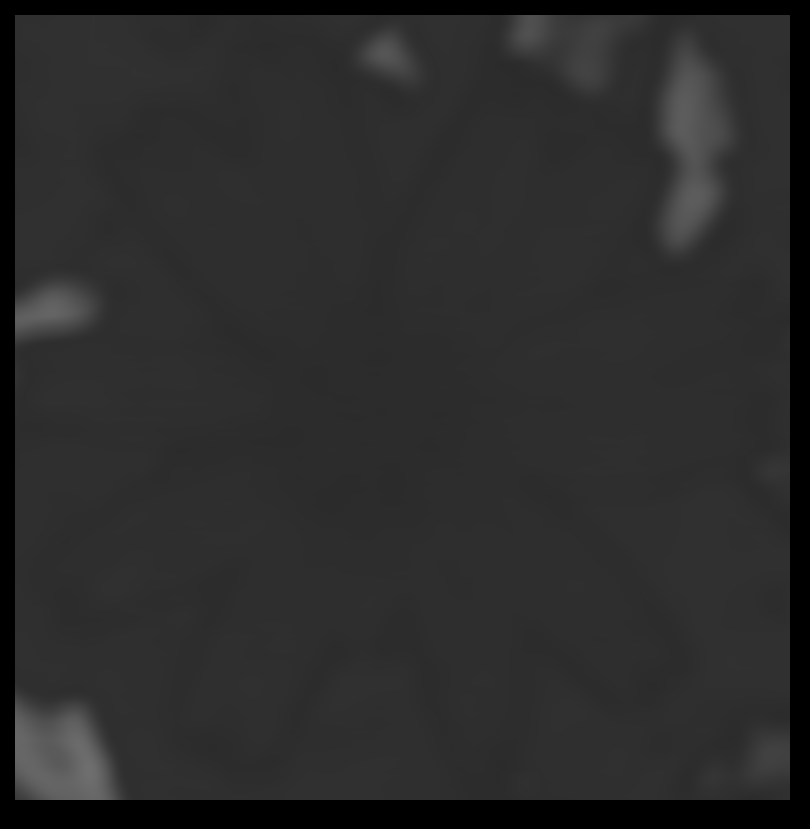

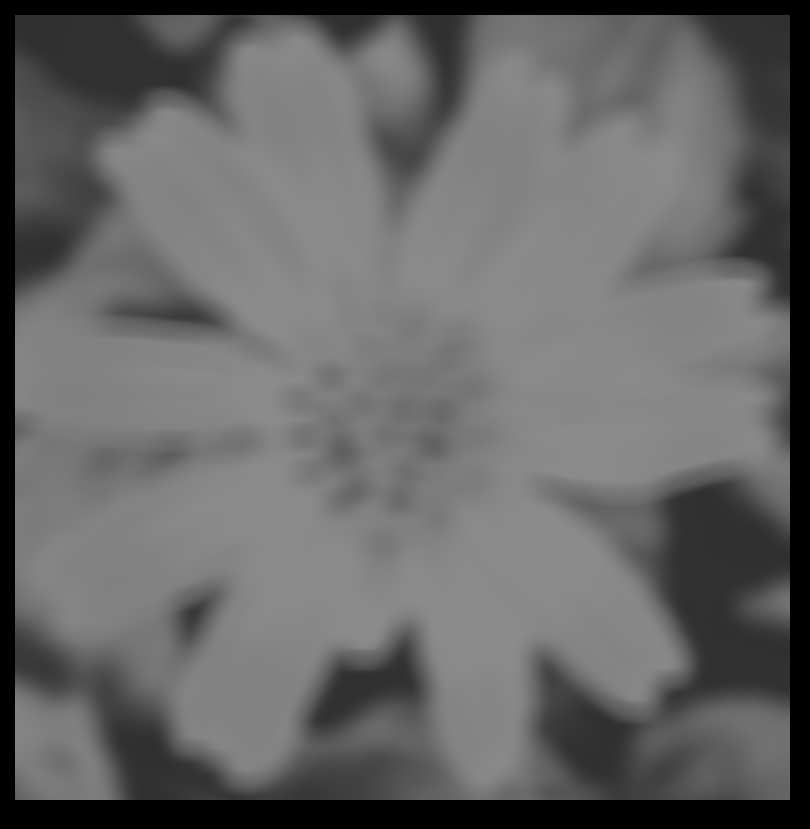

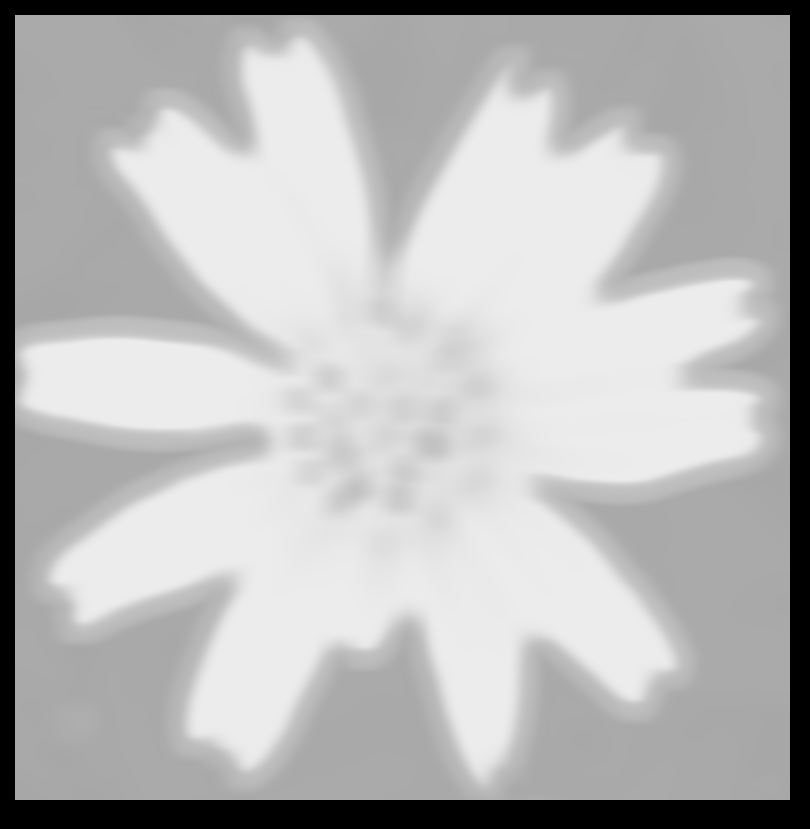

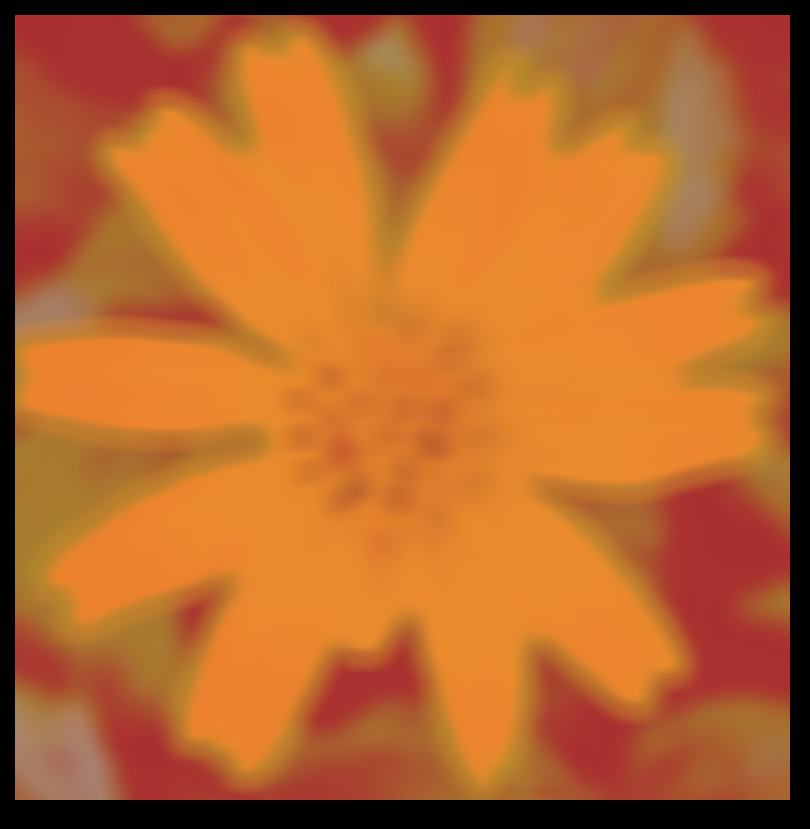

In [ ]:
#Displaying the image channel wise and then as a coloured image
cv2_imshow(predic[:,:, 0])
cv2_imshow(predic[:,:, 1])
cv2_imshow(predic[:,:, 2])
cv2_imshow(predic)

In [ ]:
#The hue is off (reddish) so the ratios of the channels are changed. We scale each channel by dividing by its max value and multiplying by 255 to correct the hue
predic[:,:,0]=predic[:,:,0]*255/np.max(predic[:,:,0])
predic[:,:,1]=predic[:,:,1]*255/np.max(predic[:,:,1])
predic[:,:,2]=predic[:,:,2]*255/np.max(predic[:,:,2])

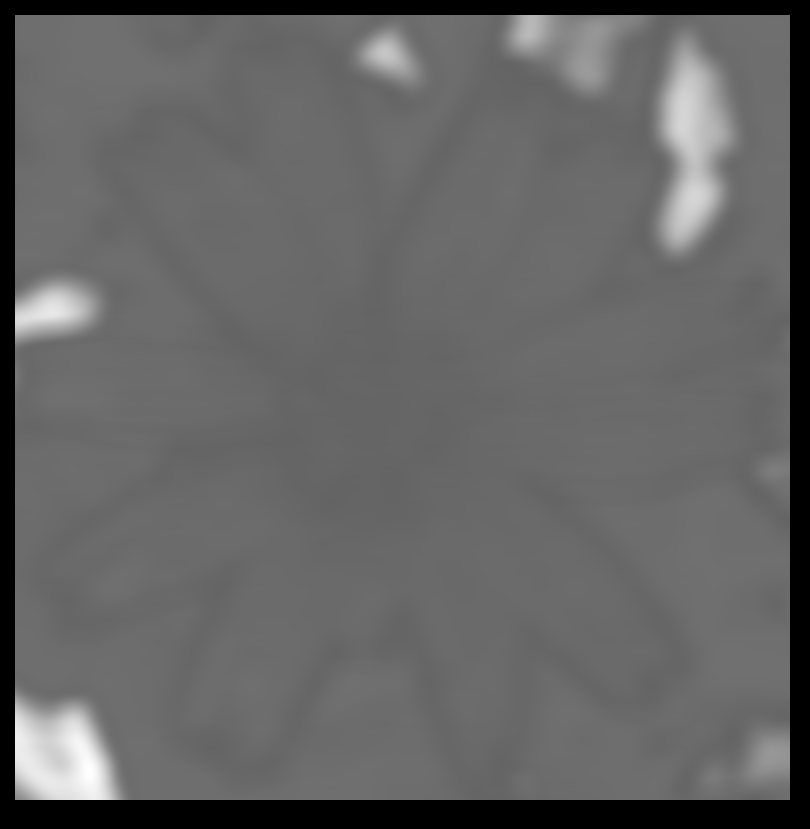

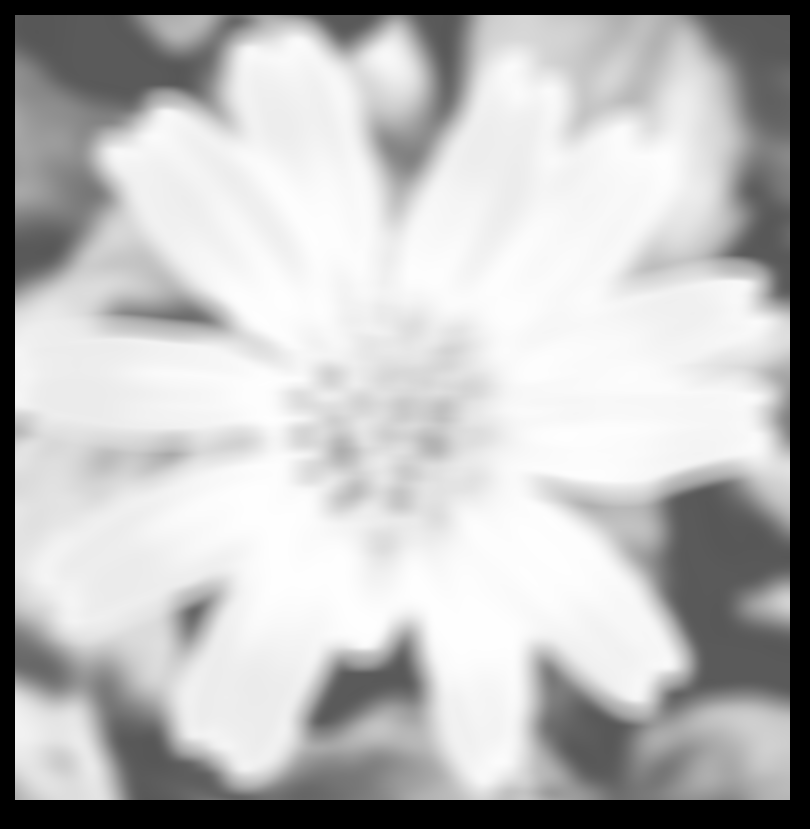

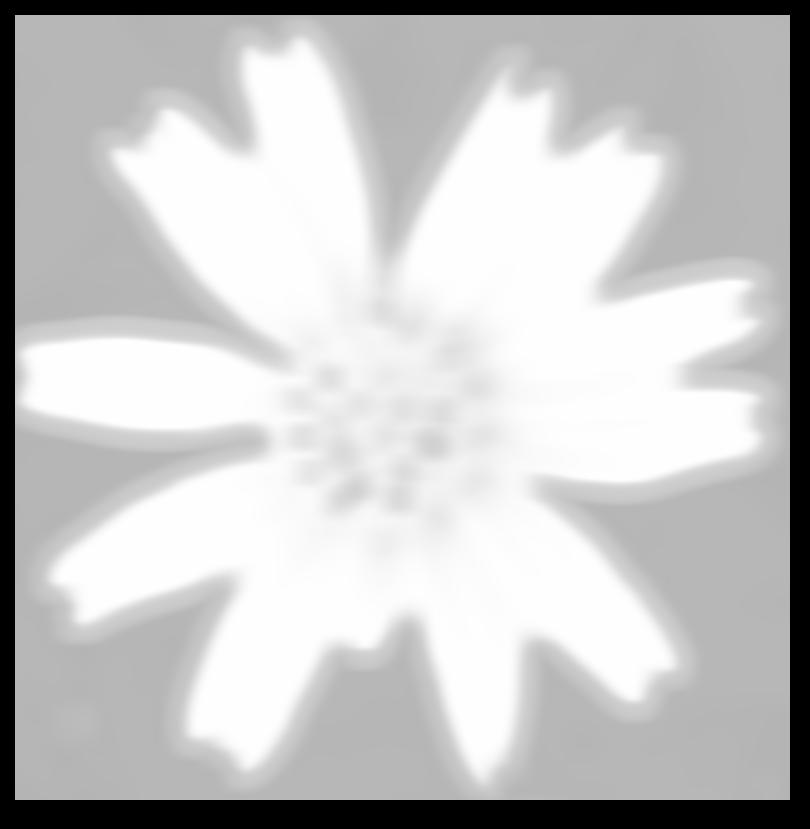

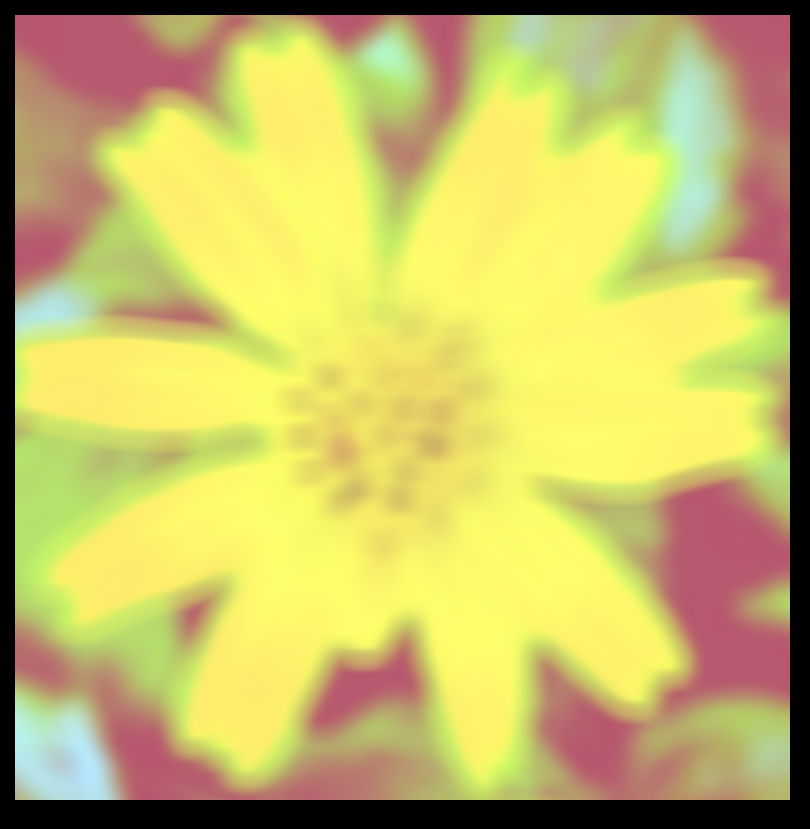

In [ ]:
#Displaying again
cv2_imshow(predic[:,:, 0])
cv2_imshow(predic[:,:, 1])
cv2_imshow(predic[:,:, 2])
cv2_imshow(predic)

The result looks like the image but it is very blurred. A better model should be used for this task.

Or, the model might work better on a different dataset..as the flowers are sharp but their background is blurred.. which could be feeding blurry patches into the model and confusing it. I could also try a different kind of noise . I will try these alternatives out.

I think it will work well on images with salt and pepper noise.

W=27 gives the best results.. but for salt and pepper noise.. a smaller w, like 9 would give good results

In [ ]:
#Similar tries on other images below:

In [ ]:
predi=np.zeros((754,766,3))
for i in range(15,735):
  for j in range(15,745):
     pabtch=np.asarray(image7b[i-a:i+a+1,j-a:j+a+1,0].ravel())
     pagtch=np.asarray(image7b[i-a:i+a+1,j-a:j+a+1,1].ravel())
     partch=np.asarray(image7b[i-a:i+a+1,j-a:j+a+1,2].ravel())
     predi[i,j,0]=bregressor.predict([pabtch])
     predi[i,j,1]=gregressor.predict([pagtch])
     predi[i,j,2]=rregressor.predict([partch])

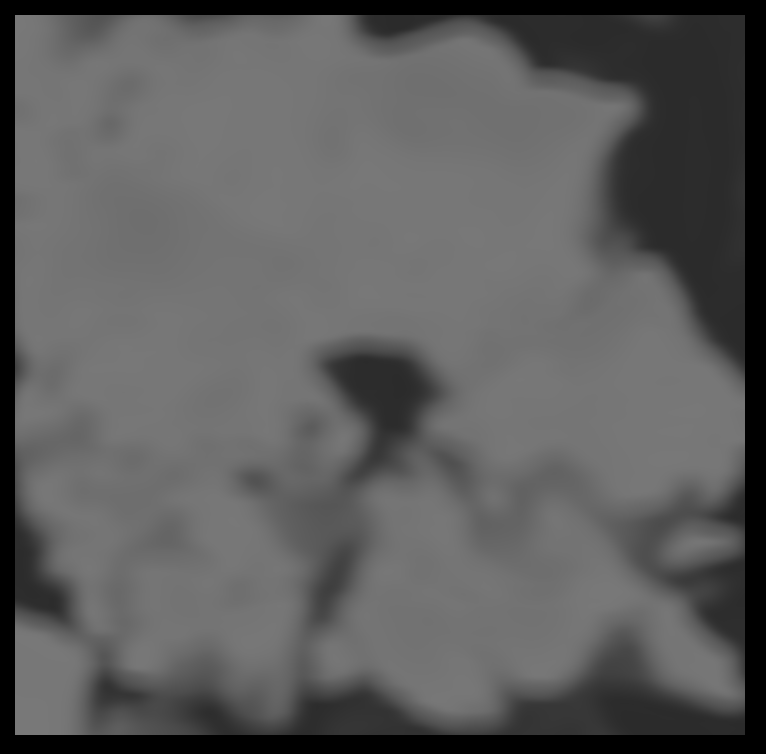

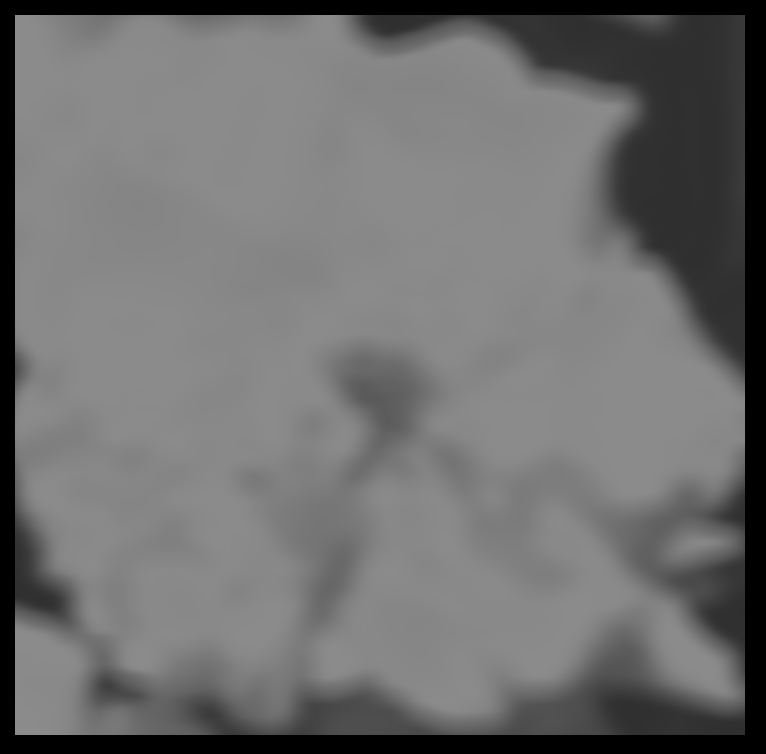

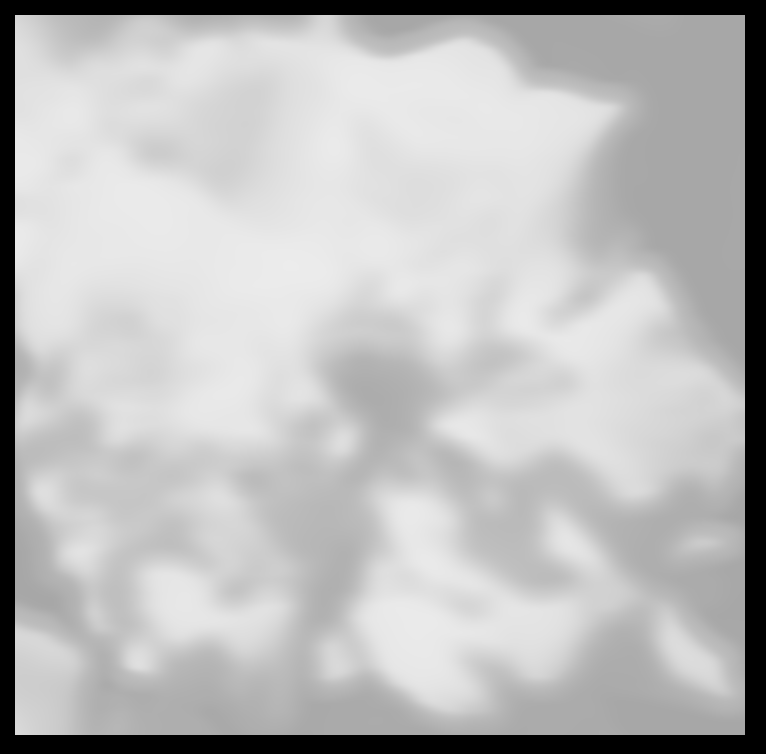

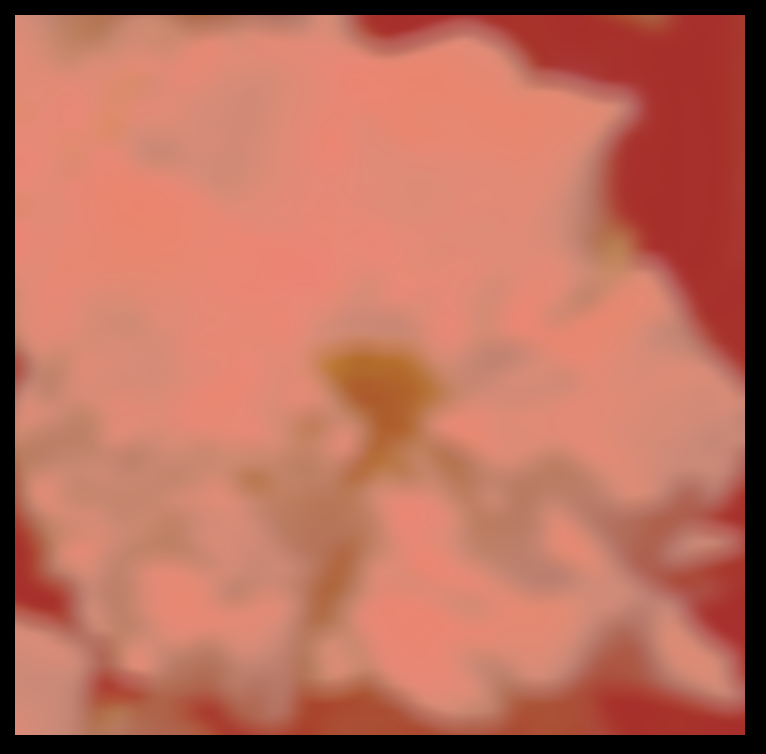

In [ ]:
cv2_imshow(predi[:,:, 0])
cv2_imshow(predi[:,:, 1])
cv2_imshow(predi[:,:, 2])
cv2_imshow(predi)

In [ ]:
predi[:,:,0]=predi[:,:,0]*255/np.max(predi[:,:,0])
predi[:,:,1]=predi[:,:,1]*255/np.max(predi[:,:,1])
predi[:,:,2]=predi[:,:,2]*255/np.max(predi[:,:,2])

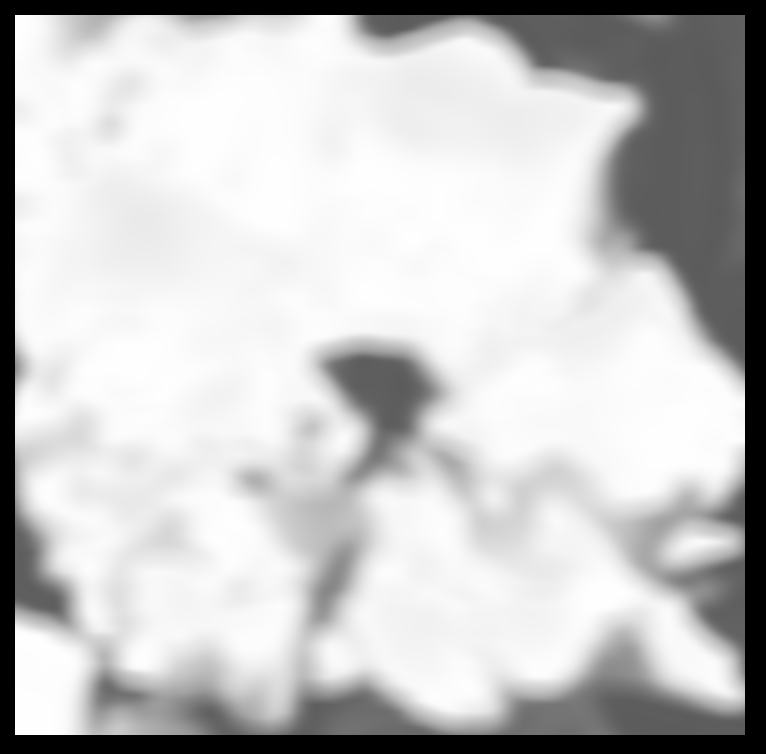

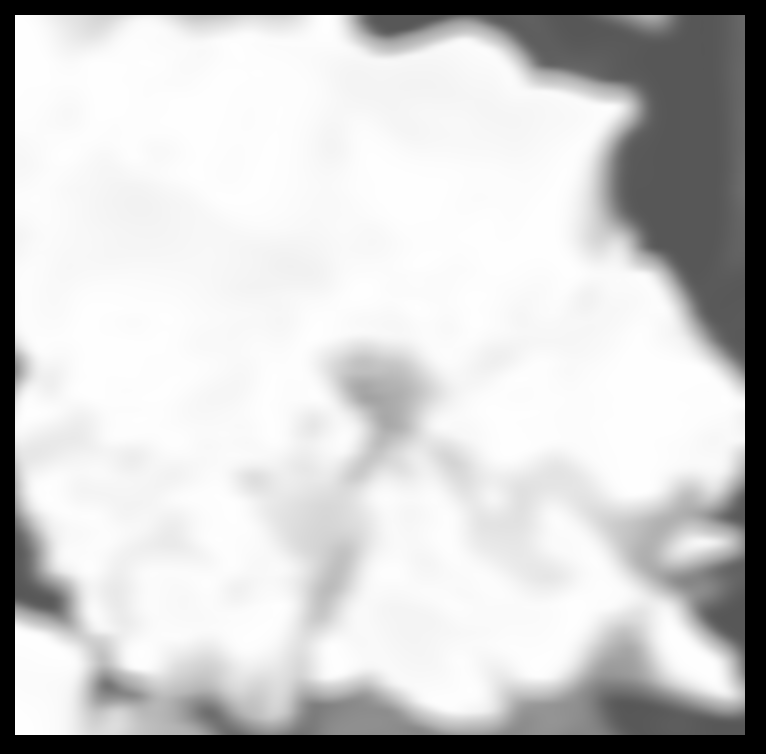

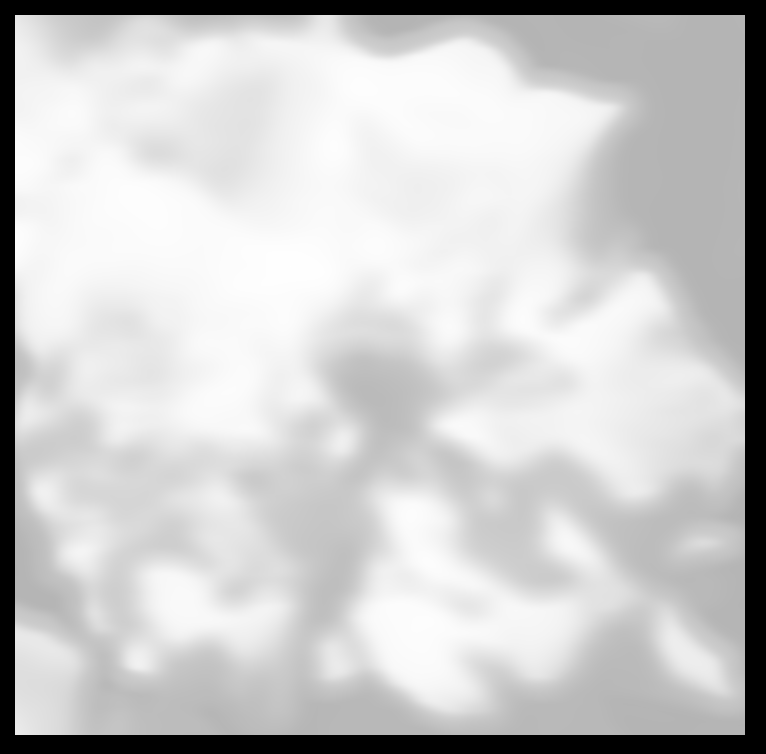

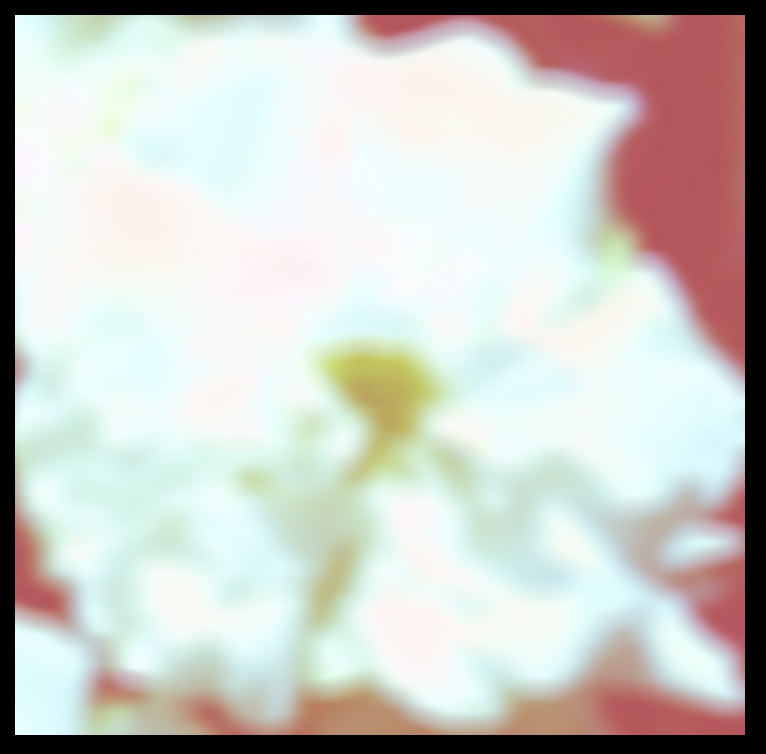

In [ ]:
cv2_imshow(predi[:,:, 0])
cv2_imshow(predi[:,:, 1])
cv2_imshow(predi[:,:, 2])
cv2_imshow(predi)

In [ ]:
pred=np.zeros((663,629,3))
for i in range(15,645):
  for j in range(15,605):
     pabtch=np.asarray(image7a[i-a:i+a+1,j-a:j+a+1,0].ravel())
     pagtch=np.asarray(image7a[i-a:i+a+1,j-a:j+a+1,1].ravel())
     partch=np.asarray(image7a[i-a:i+a+1,j-a:j+a+1,2].ravel())
     pred[i,j,0]=bregressor.predict([pabtch])
     pred[i,j,1]=gregressor.predict([pagtch])
     pred[i,j,2]=rregressor.predict([partch])


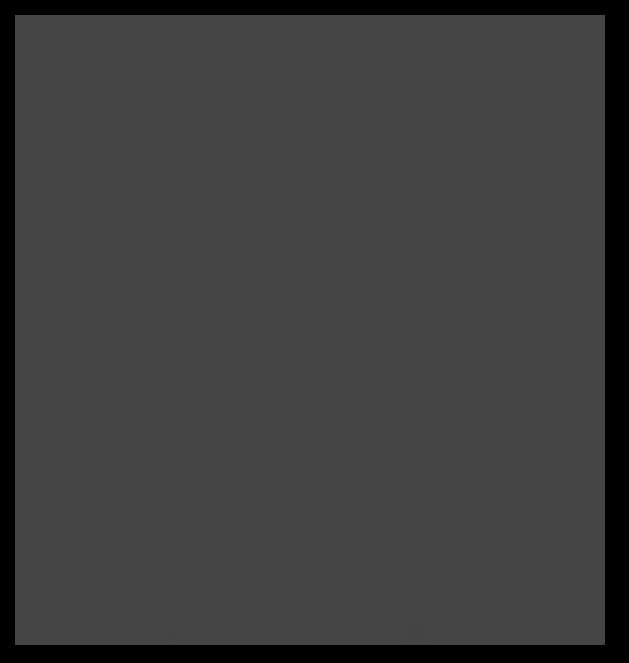

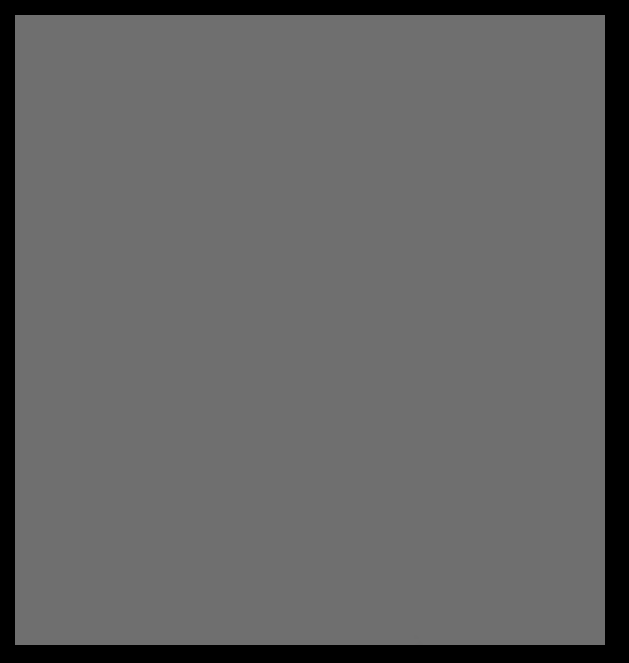

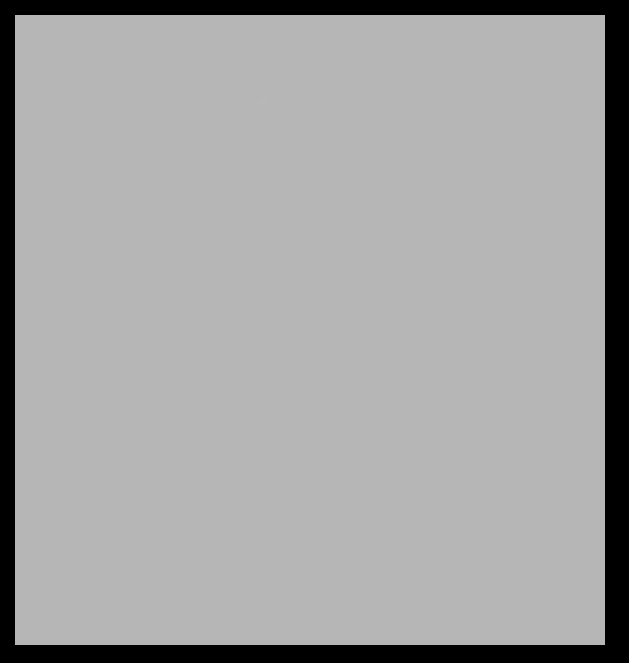

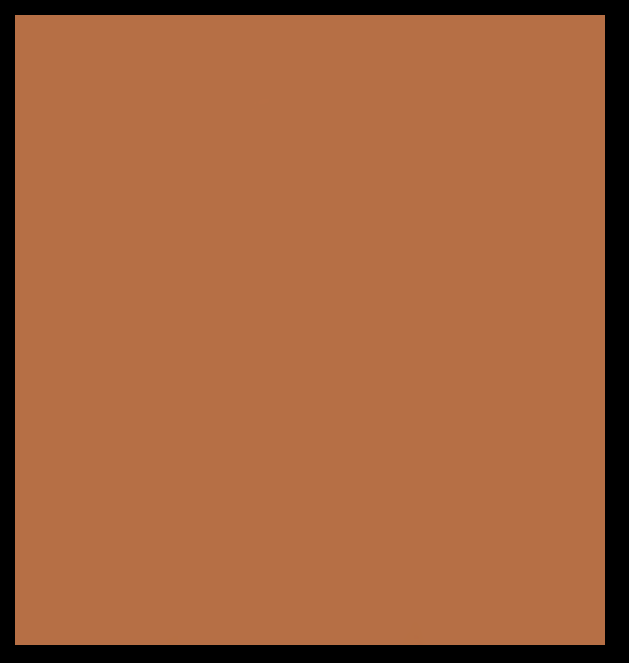

In [ ]:
cv2_imshow(pred[:,:, 0])
cv2_imshow(pred[:,:, 1])
cv2_imshow(pred[:,:, 2])
cv2_imshow(pred)

In [ ]:
pred[:,:,0]=pred[:,:,0]*255/np.max(pred[:,:,0])
pred[:,:,1]=pred[:,:,1]*255/np.max(pred[:,:,1])
pred[:,:,2]=pred[:,:,2]*255/np.max(pred[:,:,2])

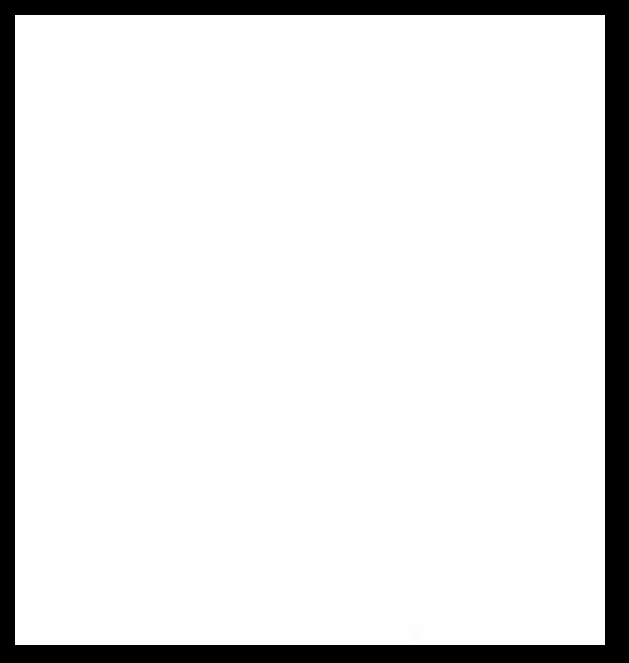

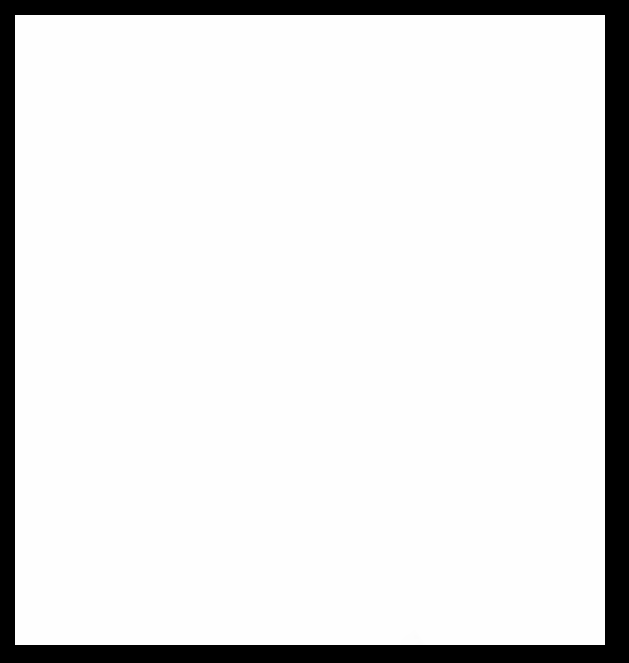

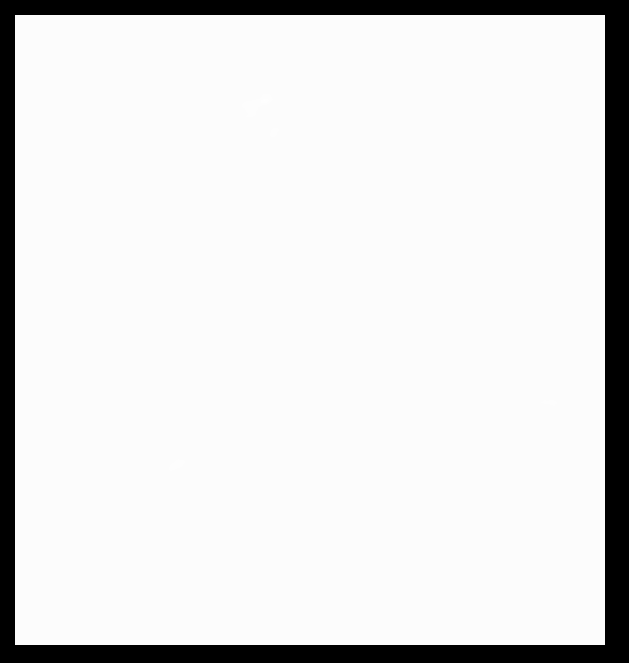

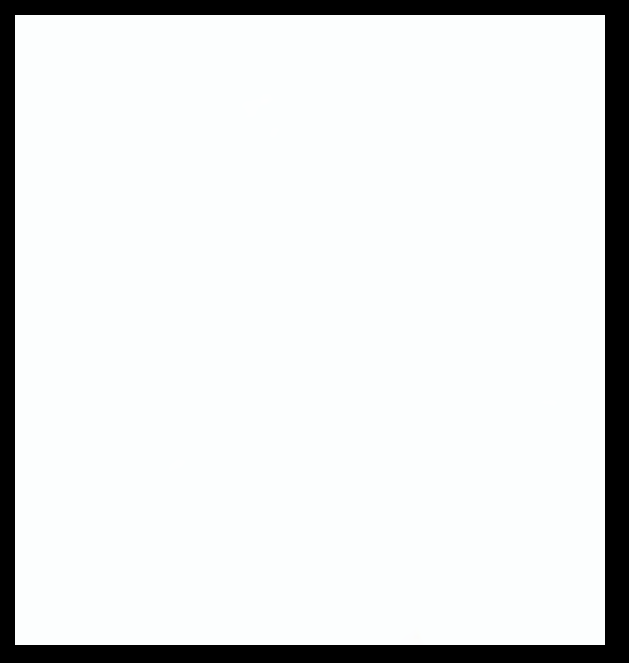

In [ ]:
cv2_imshow(pred[:,:, 0])
cv2_imshow(pred[:,:, 1])
cv2_imshow(pred[:,:, 2])
cv2_imshow(pred)